In [414]:
print("==========================================")
current_date_time <- format(Sys.time(), "%Y-%m-%d %H:%M:%S")
sprintf("[TIMESTAMP] %s", current_date_time)
print("==========================================")

[1] "=========================================="


[1] "[TIMESTAMP] 2023-09-27 10:37:57"

[1] "=========================================="


# (How to) Perform guide clustering on real ileum data 
- (prereq) have completed processing with cellranger aggr on the 4 samples of ileum data at counts stage
- (link followed) https://satijalab.org/seurat/articles/pbmc3k_tutorial.html

## Install and load packages required in R

In [415]:
# install packages
print("  begin -- installing R packages")

options(install.packages.compile.from.source = "always")
# options(pkgType="binary")

install.packages("dplyr", repos = getCRANmirrors()[1,"URL"])
install.packages("purrr", repos = getCRANmirrors()[1,"URL"])
install.packages("ggplot2", repos = getCRANmirrors()[1,"URL"])
install.packages("patchwork", repos = getCRANmirrors()[1,"URL"])
install.packages("Seurat", repos = getCRANmirrors()[1,"URL"])
install.packages("UpSetR", repos = getCRANmirrors()[1,"URL"])

print("  done  -- installing R packages")

[1] "  begin -- installing R packages"


Installing package into ‘/home/richardvan/R/x86_64-pc-linux-gnu-library/4.3’
(as ‘lib’ is unspecified)

Installing package into ‘/home/richardvan/R/x86_64-pc-linux-gnu-library/4.3’
(as ‘lib’ is unspecified)

Installing package into ‘/home/richardvan/R/x86_64-pc-linux-gnu-library/4.3’
(as ‘lib’ is unspecified)

Installing package into ‘/home/richardvan/R/x86_64-pc-linux-gnu-library/4.3’
(as ‘lib’ is unspecified)

Installing package into ‘/home/richardvan/R/x86_64-pc-linux-gnu-library/4.3’
(as ‘lib’ is unspecified)



[1] "  done  -- installing R packages"


In [ ]:
print("  begin -- installing special R packages that requires EULA acceptance")

remotes::install_github("10xGenomics/loupeR")
loupeR::setup()

print("  end -- installing special R packages that requires EULA acceptance")

In [423]:
print("  begin -- installing R Bioconductor packages")

if (!require("BiocManager", quietly = TRUE))
    install.packages("BiocManager")
BiocManager::install("SingleCellExperiment")
BiocManager::install("limma")
BiocManager::install("scater")
BiocManager::install("muscat")
    # (dependency issues) https://stackoverflow.com/questions/51940792/r-cairo-package-installation-failed-in-ubuntu-18-04
    # (for Ubuntu might need to first the following) 
    #      sudo apt-get install libx11-dev
    #      sudo apt-get install libxt-dev 
    #      sudo apt-get install libcairo2-dev


print("  end -- installing R Bioconductor packages")

[1] "  begin -- installing R Bioconductor packages"


'getOption("repos")' replaces Bioconductor standard repositories, see
'help("repositories", package = "BiocManager")' for details.
Replacement repositories:
    CRAN: https://cloud.r-project.org

Bioconductor version 3.17 (BiocManager 1.30.22), R 4.3.1 (2023-06-16)

Warning message:
“package(s) not installed when version(s) same as or greater than current; use
  `force = TRUE` to re-install: 'SingleCellExperiment'”
Installation paths not writeable, unable to update packages
  path: /usr/lib/R/library
  packages:
    boot, foreign, Matrix, nlme, spatial, survival

Old packages: 'credentials', 'GenomeInfoDb', 'gert', 'minqa', 'pbdZMQ',
  'pkgload', 'polyclip', 'prettyunits', 'S4Vectors', 'SeuratObject', 'units'

'getOption("repos")' replaces Bioconductor standard repositories, see
'help("repositories", package = "BiocManager")' for details.
Replacement repositories:
    CRAN: https://cloud.r-project.org

Bioconductor version 3.17 (BiocManager 1.30.22), R 4.3.1 (2023-06-16)

Warning messa

[1] "  end -- installing R Bioconductor packages"


In [508]:
# load packages
print("  begin -- loading packages")

library(dplyr)                  # a powerful and user-friendly package for data manipulation and transformation, 
                                #   providing a consistent and intuitive grammar to efficiently perform common data 
                                #   tasks on data frames and tibbles.  
library(ggplot2)                # data visualization package that utilizes the Grammar of Graphics principles to 
                                #   create customizable and layered plots for effective representation of complex datasets.

library(purrr)                  # provides a versatile and concise toolkit for functional programming and data manipulation, 
                                #   making it easier to work with lists and vectors by applying functions consistently 
                                #   and efficiently.

library(patchwork)              # designed to make plot composition in R extremely simple and powerful. It is mainly 
                                #   intended for users of ggplot2 and goes to great lengths to make sure ggplots are 
                                #   properly aligned no matter the complexity of your composition.
library(Seurat)                 # designed for the analysis of single-cell RNA sequencing (scRNA-seq) data, offering 
                                #   a comprehensive toolkit for preprocessing, clustering, and visualizing individual 
                                #   cell gene expression profiles.
library(loupeR)                 # provides a way to export cloupe file to be used by Loupe browser

library(SingleCellExperiment)   # designed for the efficient organization, storage, and manipulation of 
                                #   single-cell RNA sequencing (scRNA-seq) data, streamlining the analysis workflow for 
                                #   single-cell genomics studies.

library(limma)                  # for the analysis of gene expression data, providing linear models and 
                                #   empirical Bayes methods for identifying differentially expressed genes in 
                                #   microarray and RNA-Seq experiments.

library(scater)                 # designed for quality control, visualization, and preprocessing of 
                                #   single-cell RNA sequencing (scRNA-seq) data, facilitating the initial steps in the 
                                #   analysis of single-cell genomics datasets.

library(muscat)                 # multi-sample multi-group scRNA-seq analysis tools (Crowell et al. 2019) provides various 
                                #   methods and visualization tools for DS analysis in multi-sample, multi-group, 
                                #   multi-(cell-)subpopulation scRNA-seq data, including cell-level mixed models and methods 
                                #   based on aggregated “pseudobulk” data, as well as a flexible simulation platform that 
                                #   mimics both single and multi-sample scRNA-seq data.
library(UpSetR)                 # used for creating UpSet plots, which visualize intersecting sets and their sizes, 
                                #   helping to analyze and understand complex combinations of data sets efficiently.

print("  done  -- loading packages")

[1] "  begin -- loading packages"
[1] "  done  -- loading packages"


### Load the data 

In [277]:
# Load the ileum dataset that was the output of cellranger aggr
cells.data <- Read10X(data.dir = "data/realdata_forSeurat/10x_ileum/filtered_feature_bc_matrix/")
cells <- new("seurat", raw.data=cells.data)

### Code to handle sample identity
- (source) https://bioinformatics.stackexchange.com/questions/779/handling-sample-identity-in-aggregated-10x-libraries
- **note** this is an important link as it was hard to find and there isn't much support from 10x or Seurat for this

In [278]:
samples <- read.csv(file.path("data/realdata_forSeurat/10x_ileum/", "aggregation_20230926.csv"), stringsAsFactors=F)
samples

sample_id,molecule_h5,group
<chr>,<chr>,<chr>
JB_1192,/scratch/han_lab/richardvan/10x_ileum_2023/data/rawdata/counts/JB_1192_1_2/outs/molecule_info.h5,wildtype
JB_1193,/scratch/han_lab/richardvan/10x_ileum_2023/data/rawdata/counts/JB_1193_1_2/outs/molecule_info.h5,mutant
JB_1194,/scratch/han_lab/richardvan/10x_ileum_2023/data/rawdata/counts/JB_1194_1_2/outs/molecule_info.h5,wildtype
JB_1195,/scratch/han_lab/richardvan/10x_ileum_2023/data/rawdata/counts/JB_1195_1_2/outs/molecule_info.h5,mutant


In [279]:
cellcodes <- as.data.frame(cells@raw.data@Dimnames[[2]])
colnames(cellcodes) <- "barcodes"
rownames(cellcodes) <- cellcodes$barcodes
head(cellcodes)

,barcodes
,<chr>
AAACCCAAGACTTCGT-1,AAACCCAAGACTTCGT-1
AAACCCAAGGCGATAC-1,AAACCCAAGGCGATAC-1
AAACGAACAGTCGGTC-1,AAACGAACAGTCGGTC-1
AAACGAAGTAGGCAAC-1,AAACGAAGTAGGCAAC-1
AAACGAAGTCGACTTA-1,AAACGAAGTCGACTTA-1
AAACGAAGTTGCACGC-1,AAACGAAGTTGCACGC-1


In [280]:
cellcodes$libcodes <- as.factor(gsub(pattern=".+-", replacement="", cellcodes$barcodes))
head(cellcodes)

,barcodes,libcodes
,<chr>,<fct>
AAACCCAAGACTTCGT-1,AAACCCAAGACTTCGT-1,1
AAACCCAAGGCGATAC-1,AAACCCAAGGCGATAC-1,1
AAACGAACAGTCGGTC-1,AAACGAACAGTCGGTC-1,1
AAACGAAGTAGGCAAC-1,AAACGAAGTAGGCAAC-1,1
AAACGAAGTCGACTTA-1,AAACGAAGTCGACTTA-1,1
AAACGAAGTTGCACGC-1,AAACGAAGTTGCACGC-1,1


In [281]:
cellcodes$samples <- as.vector(samples$sample_id[cellcodes$libcodes])
cellcodes$groups <- as.vector(samples$group[cellcodes$libcodes])
head(cellcodes)

,barcodes,libcodes,samples,groups
,<chr>,<fct>,<chr>,<chr>
AAACCCAAGACTTCGT-1,AAACCCAAGACTTCGT-1,1,JB_1192,wildtype
AAACCCAAGGCGATAC-1,AAACCCAAGGCGATAC-1,1,JB_1192,wildtype
AAACGAACAGTCGGTC-1,AAACGAACAGTCGGTC-1,1,JB_1192,wildtype
AAACGAAGTAGGCAAC-1,AAACGAAGTAGGCAAC-1,1,JB_1192,wildtype
AAACGAAGTCGACTTA-1,AAACGAAGTCGACTTA-1,1,JB_1192,wildtype
AAACGAAGTTGCACGC-1,AAACGAAGTTGCACGC-1,1,JB_1192,wildtype


In [282]:
# Create dataframe for meta.data argument and set up object:
sampleidentity <- cellcodes[c("samples", "groups")]
head(sampleidentity)

,samples,groups
,<chr>,<chr>
AAACCCAAGACTTCGT-1,JB_1192,wildtype
AAACCCAAGGCGATAC-1,JB_1192,wildtype
AAACGAACAGTCGGTC-1,JB_1192,wildtype
AAACGAAGTAGGCAAC-1,JB_1192,wildtype
AAACGAAGTCGACTTA-1,JB_1192,wildtype
AAACGAAGTTGCACGC-1,JB_1192,wildtype


### Initialize the Seurat object with the raw (non-normalized data) and metadata of sample identity

In [283]:
cells <- CreateSeuratObject(counts = cells.data, 
                            project = "10x_ileum", 
                            min.cells = 3, 
                            min.features = 200,
                            meta.data=sampleidentity
                           )
cells

An object of class Seurat 
22309 features across 29710 samples within 1 assay 
Active assay: RNA (22309 features, 0 variable features)

### Analyzing the count matrix

In [494]:
# Lets examine a few genes in the first thirty cells
#   (about output) The . values in the matrix represent 0s (no molecules detected). Since most values in an scRNA-seq 
#     matrix are 0, Seurat uses a sparse-matrix representation whenever possible. This results in significant memory 
#     and speed savings for Drop-seq/inDrop/10x data.
cells.data[c("Smoc2", "Lgr5", "Tiam1", "Dsc2"), 1:30]

  [[ suppressing 30 column names ‘AAACCCAAGACTTCGT-1’, ‘AAACCCAAGGCGATAC-1’, ‘AAACGAACAGTCGGTC-1’ ... ]]



4 x 30 sparse Matrix of class "dgCMatrix"
                                                                   
Smoc2 . . . . . . . . . . . . . . . . 2  .  . . . . . . . 1 . . . .
Lgr5  . . . 1 . . . . . . . . 3 . . . 4 11 12 2 . . . . . . . . . .
Tiam1 . . . . . 1 . . . . . . . . . . 2  .  . 1 . . . . . . . . . .
Dsc2  1 1 . 1 . 1 . . 1 . . . . . 2 . 1  .  . . 1 1 1 . . . . . . .

In [285]:
# looking at dense vs sparse size
dense.size <- object.size(as.matrix(cells.data))
dense.size

Warning message in asMethod(object):
“sparse->dense coercion: allocating vector of size 6.9 GiB”


7385317768 bytes

In [286]:
sparse.size <- object.size(cells.data)
sparse.size

487165592 bytes

In [287]:
dense.size/sparse.size

15.2 bytes

## Standard pre-processing workflow
- selection of cells based on QC metrics
- filtration of cells based on QC metrics
- data normalization
- detection of highly variable features
- scaling of the data
- Perform linear dimensional reduction
- Determine the ‘dimensionality’ of the dataset

### Selection of cells based on QC metrics
- (QC metrics commonly used)
- The number of unique genes detected in each cell.
    * Low-quality cells or empty droplets will often have very few genes
    * Cell doublets or multiplets may exhibit an aberrantly high gene count
- Similarly, the total number of molecules detected within a cell (correlates strongly with unique genes)
- The percentage of reads that map to the mitochondrial genome
    * Low-quality / dying cells often exhibit extensive mitochondrial contamination
    * We calculate mitochondrial QC metrics with the PercentageFeatureSet() function, which calculates the percentage of counts originating from a set of features
    * We use the set of all genes starting with MT- as a set of mitochondrial genes

In [289]:
# The [[ operator can add columns to object metadata. This is a great place to stash QC stats
cells[["percent.mt"]] <- PercentageFeatureSet(cells, pattern = "^MT-")

In [290]:
# Show QC metrics for the first 5 cells
#   (note) the number of unique genes and total molecules are automatically calcualted during CreateSeuratObject()
head(cells@meta.data, 5)

,orig.ident,nCount_RNA,nFeature_RNA,samples,groups,percent.mt
,<fct>,<dbl>,<int>,<chr>,<chr>,<dbl>
AAACCCAAGACTTCGT-1,10x_ileum,1987,1237,JB_1192,wildtype,0
AAACCCAAGGCGATAC-1,10x_ileum,4086,1894,JB_1192,wildtype,0
AAACGAACAGTCGGTC-1,10x_ileum,1165,811,JB_1192,wildtype,0
AAACGAAGTAGGCAAC-1,10x_ileum,529,438,JB_1192,wildtype,0
AAACGAAGTCGACTTA-1,10x_ileum,3405,1751,JB_1192,wildtype,0


### Filtration of cells based on QC metrics after visualization

Warning message in SingleExIPlot(type = type, data = data[, x, drop = FALSE], idents = idents, :
“All cells have the same value of percent.mt.”


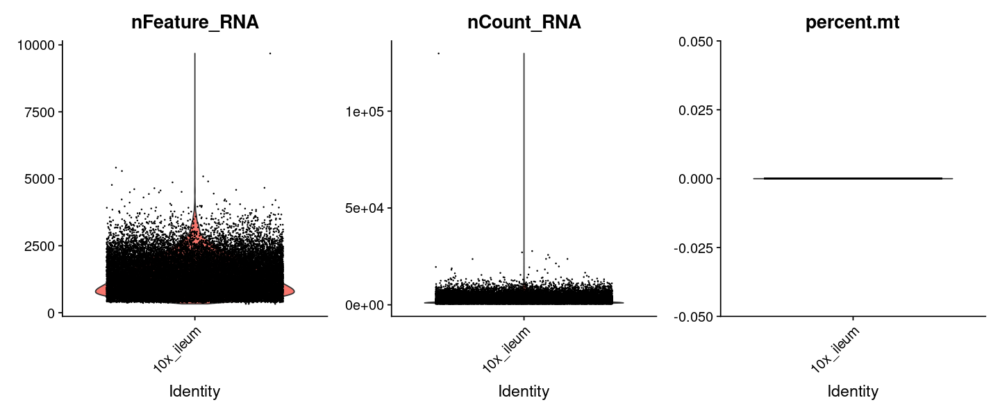

In [291]:
# Visualize QC metrics as a violin plot
options(repr.plot.height = 5, repr.plot.width = 12)
VlnPlot(cells, features = c("nFeature_RNA", "nCount_RNA", "percent.mt"), ncol = 3)

Warning message in cor(x = data[, 1], y = data[, 2]):
“the standard deviation is zero”


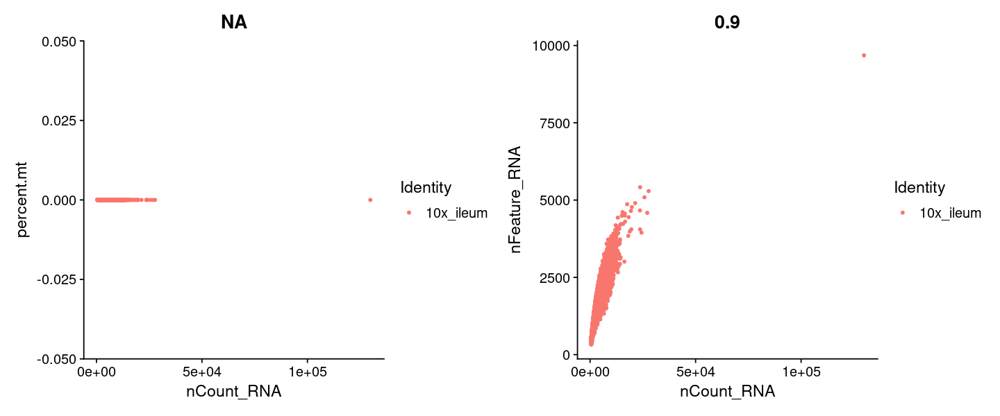

In [292]:
# FeatureScatter is typically used to visualize feature-feature relationships, but can be used
# for anything calculated by the object, i.e. columns in object metadata, PC scores etc.
plot1 <- FeatureScatter(cells, feature1 = "nCount_RNA", feature2 = "percent.mt")
plot2 <- FeatureScatter(cells, feature1 = "nCount_RNA", feature2 = "nFeature_RNA")
plot1 + plot2

In [303]:
# preview 'ileum' before
dim(cells.data)
head(cells.data, 5)

[1] 31053 29710

  [[ suppressing 34 column names ‘AAACCCAAGACTTCGT-1’, ‘AAACCCAAGGCGATAC-1’, ‘AAACGAACAGTCGGTC-1’ ... ]]



5 x 29710 sparse Matrix of class "dgCMatrix"
                                                                           
Xkr4    . . . . . . . 3 . . . . . . . . . . . . . . . . . . . . . . . . . .
Gm1992  . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . .
Gm37381 . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . .
Rp1     . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . .
Sox17   . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . .
              
Xkr4    ......
Gm1992  ......
Gm37381 ......
Rp1     ......
Sox17   ......

 .....suppressing 29676 columns in show(); maybe adjust 'options(max.print= *, width = *)'
 ..............................

In [294]:
# the actual call to filter
# - We filter cells that have unique feature counts over 2,500 or less than 200
# - We filter cells that have >5% mitochondrial counts

cells <- subset(cells, subset = nFeature_RNA > 200 & nFeature_RNA < 5000 & percent.mt < 5)

In [ ]:
# preview 'ileum' after
dim(cells.data)
head(cells.data, 5)

Warning message in SingleExIPlot(type = type, data = data[, x, drop = FALSE], idents = idents, :
“All cells have the same value of percent.mt.”


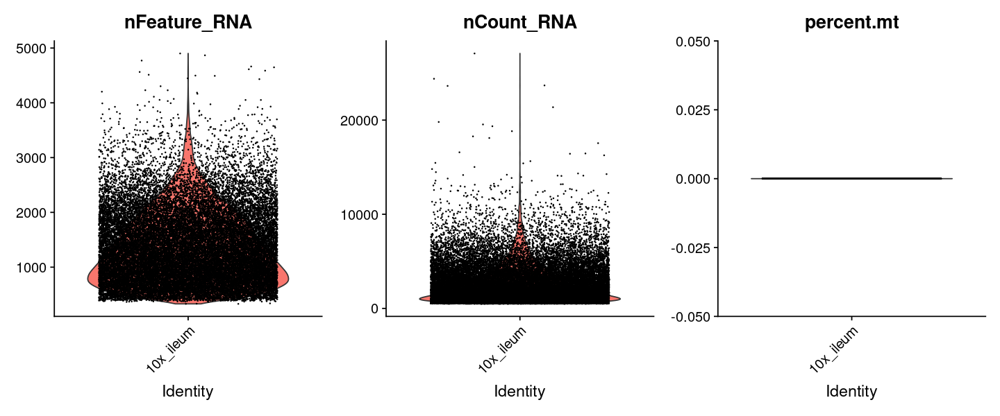

In [296]:
# Visualize QC metrics as a violin plot
options(repr.plot.height = 5, repr.plot.width = 12)
VlnPlot(cells, features = c("nFeature_RNA", "nCount_RNA", "percent.mt"), ncol = 3)

Warning message in cor(x = data[, 1], y = data[, 2]):
“the standard deviation is zero”


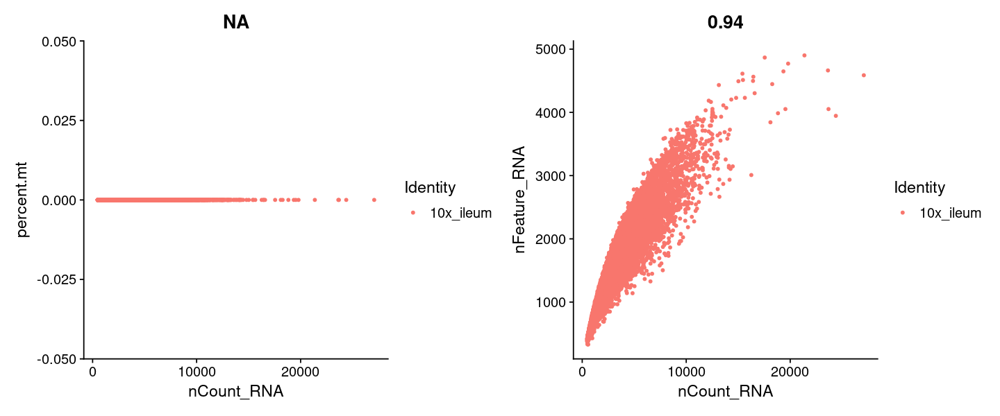

In [297]:
# FeatureScatter is typically used to visualize feature-feature relationships, but can be used
# for anything calculated by the object, i.e. columns in object metadata, PC scores etc.
plot1 <- FeatureScatter(cells, feature1 = "nCount_RNA", feature2 = "percent.mt")
plot2 <- FeatureScatter(cells, feature1 = "nCount_RNA", feature2 = "nFeature_RNA")
plot1 + plot2

### Data normalization
- By default, we employ a global-scaling normalization method “LogNormalize” that normalizes the feature expression measurements for each cell by the total expression, multiplies this by a scale factor (10,000 by default), and log-transforms the result. Normalized values are stored in pbmc[["RNA"]]@data.

In [301]:
# preview 'ileum' before
head(cells.data, 5)

  [[ suppressing 34 column names ‘AAACCCAAGACTTCGT-1’, ‘AAACCCAAGGCGATAC-1’, ‘AAACGAACAGTCGGTC-1’ ... ]]



5 x 29710 sparse Matrix of class "dgCMatrix"
                                                                           
Xkr4    . . . . . . . 3 . . . . . . . . . . . . . . . . . . . . . . . . . .
Gm1992  . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . .
Gm37381 . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . .
Rp1     . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . .
Sox17   . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . .
              
Xkr4    ......
Gm1992  ......
Gm37381 ......
Rp1     ......
Sox17   ......

 .....suppressing 29676 columns in show(); maybe adjust 'options(max.print= *, width = *)'
 ..............................

In [299]:
cells <- NormalizeData(cells, normalization.method = "LogNormalize", scale.factor = 10000)

In [302]:
# preview 'ileum' after
head(cells.data, 5)

  [[ suppressing 34 column names ‘AAACCCAAGACTTCGT-1’, ‘AAACCCAAGGCGATAC-1’, ‘AAACGAACAGTCGGTC-1’ ... ]]



5 x 29710 sparse Matrix of class "dgCMatrix"
                                                                           
Xkr4    . . . . . . . 3 . . . . . . . . . . . . . . . . . . . . . . . . . .
Gm1992  . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . .
Gm37381 . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . .
Rp1     . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . .
Sox17   . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . .
              
Xkr4    ......
Gm1992  ......
Gm37381 ......
Rp1     ......
Sox17   ......

 .....suppressing 29676 columns in show(); maybe adjust 'options(max.print= *, width = *)'
 ..............................

### Identification of highly variable features (feature selection)
- We next calculate a subset of features that exhibit high cell-to-cell variation in the dataset 
    * (i.e, they are highly expressed in some cells, and lowly expressed in others). 
- **We and others have found that focusing on these genes in downstream analysis helps to highlight biological signal in single-cell datasets.**
- Our procedure in Seurat is described in detail here, and improves on previous versions by directly modeling the mean-variance relationship inherent in single-cell data, and is implemented in the FindVariableFeatures() function. 
- By default, we return 2,000 features per dataset. These will be used in downstream analysis, like PCA.

In [306]:
# preview 'ileum' before
dim(cells.data)
head(cells.data, 5)

[1] 31053 29710

  [[ suppressing 34 column names ‘AAACCCAAGACTTCGT-1’, ‘AAACCCAAGGCGATAC-1’, ‘AAACGAACAGTCGGTC-1’ ... ]]



5 x 29710 sparse Matrix of class "dgCMatrix"
                                                                           
Xkr4    . . . . . . . 3 . . . . . . . . . . . . . . . . . . . . . . . . . .
Gm1992  . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . .
Gm37381 . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . .
Rp1     . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . .
Sox17   . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . .
              
Xkr4    ......
Gm1992  ......
Gm37381 ......
Rp1     ......
Sox17   ......

 .....suppressing 29676 columns in show(); maybe adjust 'options(max.print= *, width = *)'
 ..............................

In [307]:
cells <- FindVariableFeatures(cells, selection.method = "vst", nfeatures = 2000)

In [308]:
# preview 'ileum' after
dim(cells.data)
head(cells.data, 5)

[1] 31053 29710

  [[ suppressing 34 column names ‘AAACCCAAGACTTCGT-1’, ‘AAACCCAAGGCGATAC-1’, ‘AAACGAACAGTCGGTC-1’ ... ]]



5 x 29710 sparse Matrix of class "dgCMatrix"
                                                                           
Xkr4    . . . . . . . 3 . . . . . . . . . . . . . . . . . . . . . . . . . .
Gm1992  . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . .
Gm37381 . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . .
Rp1     . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . .
Sox17   . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . .
              
Xkr4    ......
Gm1992  ......
Gm37381 ......
Rp1     ......
Sox17   ......

 .....suppressing 29676 columns in show(); maybe adjust 'options(max.print= *, width = *)'
 ..............................

In [309]:
# Identify the 10 most highly variable genes
top10 <- head(VariableFeatures(cells), 10)
top10

[1] "Csmd1"   "Kcnb2"   "Dgkb"    "Prkg1"   "Cacnb2"  "Fam155a" "Myh11"  
 [8] "Chrm2"   "Nrxn1"   "Pcdh15"

When using repel, set xnudge and ynudge to 0 for optimal results



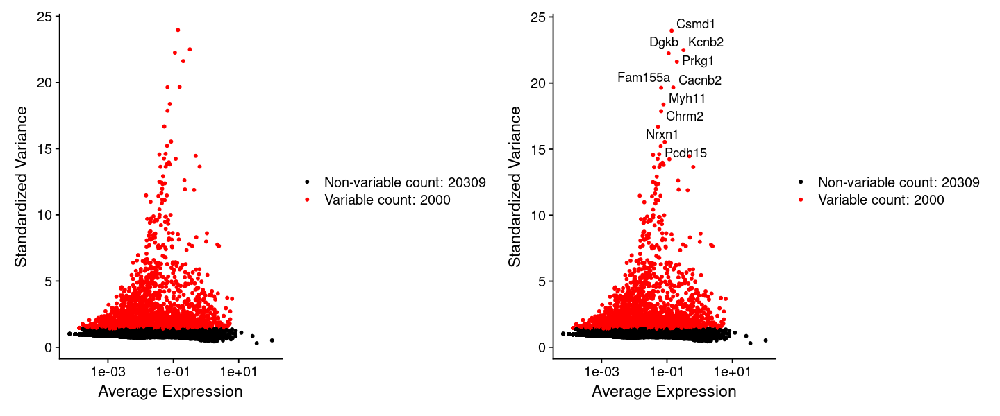

In [310]:
# plot variable features with and without labels
plot1 <- VariableFeaturePlot(cells)
plot2 <- LabelPoints(plot = plot1, points = top10, repel = TRUE)
plot1 + plot2

### Scaling the data
- The ScaleData() function:
    * Shifts the expression of each gene, so that the mean expression across cells is 0
    * Scales the expression of each gene, so that the variance across cells is 1
        + This step gives equal weight in downstream analyses, so that highly-expressed genes do not dominate
    * The results of this are stored in pbmc[["RNA"]]@scale.data

In [311]:
# preview before
dim(cells.data)
head(cells.data, 5)

[1] 31053 29710

  [[ suppressing 34 column names ‘AAACCCAAGACTTCGT-1’, ‘AAACCCAAGGCGATAC-1’, ‘AAACGAACAGTCGGTC-1’ ... ]]



5 x 29710 sparse Matrix of class "dgCMatrix"
                                                                           
Xkr4    . . . . . . . 3 . . . . . . . . . . . . . . . . . . . . . . . . . .
Gm1992  . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . .
Gm37381 . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . .
Rp1     . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . .
Sox17   . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . .
              
Xkr4    ......
Gm1992  ......
Gm37381 ......
Rp1     ......
Sox17   ......

 .....suppressing 29676 columns in show(); maybe adjust 'options(max.print= *, width = *)'
 ..............................

In [312]:
# Performing the scaling step 
all.genes <- rownames(cells)
cells <- ScaleData(cells, features = all.genes)

Centering and scaling data matrix



In [313]:
# preview after
dim(cells.data)
head(cells.data, 5)

[1] 31053 29710

  [[ suppressing 34 column names ‘AAACCCAAGACTTCGT-1’, ‘AAACCCAAGGCGATAC-1’, ‘AAACGAACAGTCGGTC-1’ ... ]]



5 x 29710 sparse Matrix of class "dgCMatrix"
                                                                           
Xkr4    . . . . . . . 3 . . . . . . . . . . . . . . . . . . . . . . . . . .
Gm1992  . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . .
Gm37381 . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . .
Rp1     . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . .
Sox17   . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . .
              
Xkr4    ......
Gm1992  ......
Gm37381 ......
Rp1     ......
Sox17   ......

 .....suppressing 29676 columns in show(); maybe adjust 'options(max.print= *, width = *)'
 ..............................

### Perform linear dimensional reduction (PCA) on the scaled data
- By default, only the previously determined variable features are used as input, but can be defined using features argument if you wish to choose a different subset.

In [314]:
# the actual PCA call
cells <- RunPCA(cells, features = VariableFeatures(object = cells))

PC_ 1 
Positive:  Zdhhc14, Plcb1, Kcnma1, Chrm3, 5330417C22Rik, Cracr2a, Ptprn2, Fry, Arhgap24, Ccnd3 
	   Gm609, Slc12a8, Car8, Ica1, Sytl2, Tnfaip8, Nav2, Spink4, Slc12a2, Sidt1 
	   Muc2, Sntb1, Galnt7, Arhgef38, 2610035D17Rik, Naaladl2, Tanc2, Inpp4b, Klf12, Hepacam2 
Negative:  Ace2, Cubn, Aspa, Maf, Slc15a1, Slc5a1, Abcc2, Abcb1a, Slc13a1, Sema6a 
	   2010106E10Rik, Pls1, Gramd1b, Cyp3a13, Dpp4, Slc13a2, Clec2e, Slc10a2, Enpep, Cobl 
	   Mertk, Sis, Apob, Vil1, Anpep, Ceacam20, Gda, Mep1b, Nlrp9b, Slc6a19 
PC_ 2 
Positive:  Plcb1, Ptprn2, 5330417C22Rik, Sytl2, Chrm3, Slc12a8, Kcnma1, Shroom3, Hepacam2, Ica1 
	   Cracr2a, Gm609, Car8, Srgap1, Galnt7, Muc2, Spink4, Rab27b, Bcas1, Fut8 
	   Tanc2, Agr2, Myrip, 9030622O22Rik, Mcf2l, Arfgef3, Arhgef38, Fam189a1, Naaladl2, Asph 
Negative:  Arhgap15, Dock2, Ptprc, Aff3, Prkcb, Ebf1, Gm26740, Bank1, Dock10, Ikzf3 
	   Ikzf1, Fli1, Pax5, Mef2c, Ripor2, Inpp5d, St6galnac3, Wdfy4, Sh3kbp1, Akt3 
	   March1, Btla, Pip4k2a, Zeb1, Kcnq5, Ppp1r

In [315]:
# preview 'pbmc' after
dim(cells.data)
head(cells.data, 5)

[1] 31053 29710

  [[ suppressing 34 column names ‘AAACCCAAGACTTCGT-1’, ‘AAACCCAAGGCGATAC-1’, ‘AAACGAACAGTCGGTC-1’ ... ]]



5 x 29710 sparse Matrix of class "dgCMatrix"
                                                                           
Xkr4    . . . . . . . 3 . . . . . . . . . . . . . . . . . . . . . . . . . .
Gm1992  . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . .
Gm37381 . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . .
Rp1     . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . .
Sox17   . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . .
              
Xkr4    ......
Gm1992  ......
Gm37381 ......
Rp1     ......
Sox17   ......

 .....suppressing 29676 columns in show(); maybe adjust 'options(max.print= *, width = *)'
 ..............................

In [316]:
# Examine and visualize PCA results a few different ways
print(cells[["pca"]], dims = 1:5, nfeatures = 5)

PC_ 1 
Positive:  Zdhhc14, Plcb1, Kcnma1, Chrm3, 5330417C22Rik 
Negative:  Ace2, Cubn, Aspa, Maf, Slc15a1 
PC_ 2 
Positive:  Plcb1, Ptprn2, 5330417C22Rik, Sytl2, Chrm3 
Negative:  Arhgap15, Dock2, Ptprc, Aff3, Prkcb 
PC_ 3 
Positive:  Prkg1, 9530026P05Rik, Meis2, Pcdh7, Dlc1 
Negative:  Bank1, Ebf1, Pax5, Dock2, Arhgap15 
PC_ 4 
Positive:  Inpp4b, Ptprr, Bach2, Arhgap15, Dock2 
Negative:  Kcnq1, Cftr, Sema5a, Cps1, Pde8b 
PC_ 5 
Positive:  Samd5, Itln1, Lyz1, Mmp7, Defa24 
Negative:  Fcgbp, Fer1l6, Clca1, Frmd3, Zg16 


#### Seurat provides several useful ways of visualizing both cells and features that define the PCA
- VizDimReduction()
- DimPlot()
- DimHeatmap()
    * In particular DimHeatmap() allows for easy exploration of the primary sources of heterogeneity in a dataset, and can be useful when trying to decide which PCs to include for further downstream analyses. 
    * Both cells and features are ordered according to their PCA scores. 
    * Setting cells to a number plots the ‘extreme’ cells on both ends of the spectrum, which dramatically speeds plotting for large datasets. 
    * Though clearly a supervised analysis, we find this to be a valuable tool for exploring correlated feature sets.

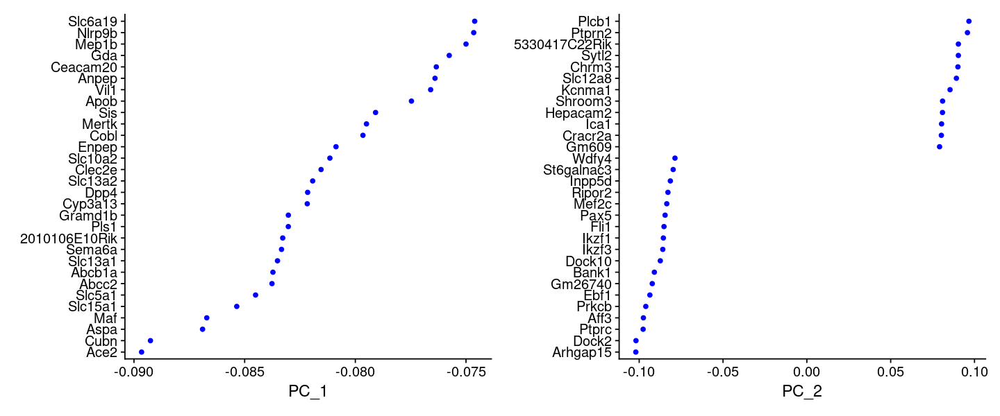

In [317]:
VizDimLoadings(cells, dims = 1:2, reduction = "pca")

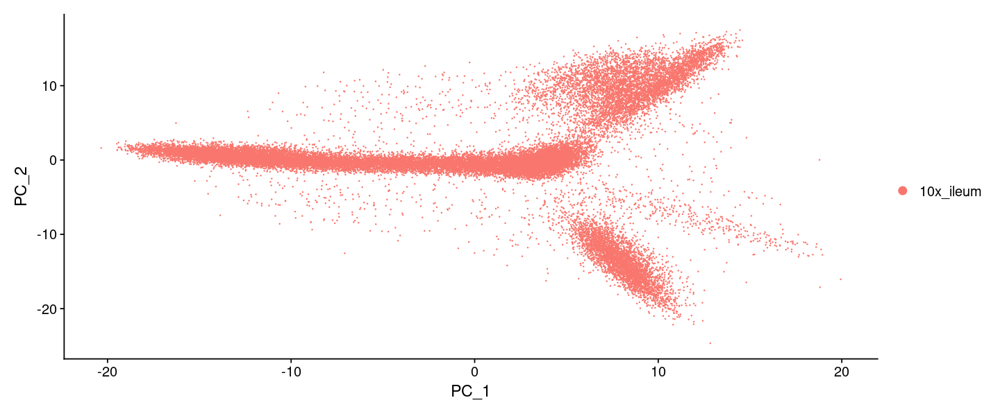

In [318]:
DimPlot(cells, reduction = "pca")

In [ ]:
# heatmap of the first PC
# Specify plot sizes to be increased for plots made by Seurat functions
options(repr.plot.height = 8, repr.plot.width = 8)
DimHeatmap(cells, dims = 1, cells = 500, balanced = TRUE)

In [ ]:
# heatmap of 15 PCs
options(repr.plot.height = 18, repr.plot.width = 12)
DimHeatmap(cells, dims = 1:15, cells = 500, balanced = TRUE)

### Determine the ‘dimensionality’ of the dataset
- To overcome the extensive technical noise in any single feature for scRNA-seq data, Seurat clusters cells based on their PCA scores, with each PC essentially representing a ‘metafeature’ that combines information across a correlated feature set. 
- The top principal components therefore represent a robust compression of the dataset. 
- However, how many components should we choose to include? 10? 20? 100?

In [322]:
# The JackStrawPlot() function 
#   (provides) a visualization tool for comparing the distribution of p-values for each PC with a uniform 
#     distribution (dashed line). ‘Significant’ PCs will show a strong enrichment of features with 
#     low p-values (solid curve above the dashed line). 
#     In this case it appears that there is a sharp drop-off in significance after the first 10-12 PCs.

# preview 'pbmc' before
head(cells, 5)

,orig.ident,nCount_RNA,nFeature_RNA,samples,groups,percent.mt
,<fct>,<dbl>,<int>,<chr>,<chr>,<dbl>
AAACCCAAGACTTCGT-1,10x_ileum,1987,1237,JB_1192,wildtype,0
AAACCCAAGGCGATAC-1,10x_ileum,4086,1894,JB_1192,wildtype,0
AAACGAACAGTCGGTC-1,10x_ileum,1165,811,JB_1192,wildtype,0
AAACGAAGTAGGCAAC-1,10x_ileum,529,438,JB_1192,wildtype,0
AAACGAAGTCGACTTA-1,10x_ileum,3405,1751,JB_1192,wildtype,0


In [323]:
# # DOES NOT WORK FOR ILEUM DATA

# # NOTE: This process can take a long time for big datasets, comment out for expediency. More
# # approximate techniques such as those implemented in ElbowPlot() can be used to reduce
# # computation time
# cells <- JackStraw(cells, num.replicate = 20)

In [ ]:
# # preview 'pbmc' after JackStraw() call and before ScoreJackStraw() call
# head(cells, 5)

In [ ]:
# cells <- ScoreJackStraw(cells, dims = 1:10)

In [ ]:
# # preview 'pbmc' after
# head(cells, 5)

In [ ]:
# options(repr.plot.height = 8, repr.plot.width = 8)
# JackStrawPlot(cells, dims = 1:10)

In [324]:
# The ElbowPlot() function 
#   (provides) An alternative heuristic method generates a ranking of principle components based on the percentage 
#     of variance explained by each one (ElbowPlot() function). In this example, we can observe an ‘elbow’ 
#     around PC9-10, suggesting that the majority of true signal is captured in the first 10 PCs.

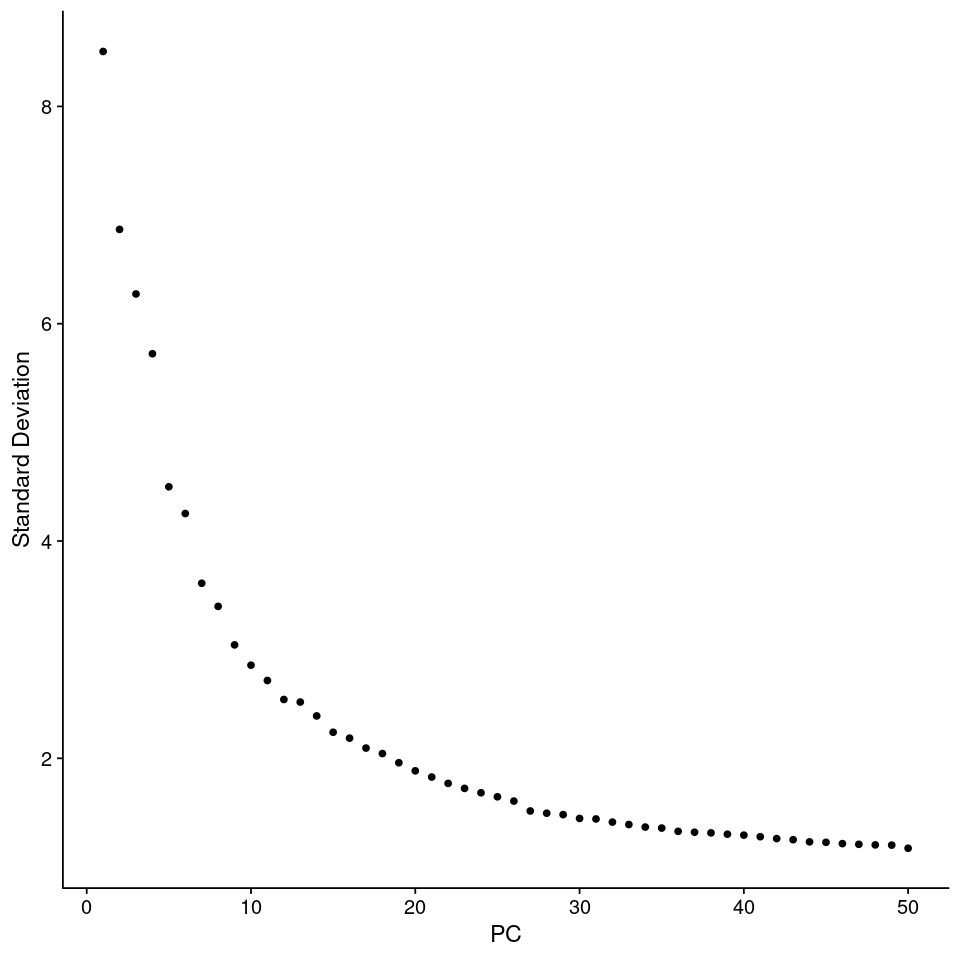

In [325]:
options(repr.plot.height = 8, repr.plot.width = 8)
ElbowPlot(cells, ndims=50)

## Cluster the cells
- the FindNeighbors() function
    * takes as input the previously defined dimensionality of the dataset (first 10 PCs).
    * we first construct a KNN graph based on the euclidean distance in PCA space, and refine the edge weights between any two cells based on the shared overlap in their local neighborhoods (Jaccard similarity)
- the FindClusters() function
    * we next apply modularity optimization techniques such as the Louvain algorithm (default) or SLM to iteratively group cells together, with the goal of optimizing the standard modularity function
    * contains a resolution parameter that sets the ‘granularity’ of the downstream clustering, with increased values leading to a greater number of clusters.
        + We find that setting this parameter between 0.4-1.2 typically returns good results for single-cell datasets of around 3K cells.
        + Optimal resolution often increases for larger datasets.
    * The clusters can be found using the Idents() function.

In [326]:
# preview  before
head(cells, 5)

,orig.ident,nCount_RNA,nFeature_RNA,samples,groups,percent.mt
,<fct>,<dbl>,<int>,<chr>,<chr>,<dbl>
AAACCCAAGACTTCGT-1,10x_ileum,1987,1237,JB_1192,wildtype,0
AAACCCAAGGCGATAC-1,10x_ileum,4086,1894,JB_1192,wildtype,0
AAACGAACAGTCGGTC-1,10x_ileum,1165,811,JB_1192,wildtype,0
AAACGAAGTAGGCAAC-1,10x_ileum,529,438,JB_1192,wildtype,0
AAACGAAGTCGACTTA-1,10x_ileum,3405,1751,JB_1192,wildtype,0


In [327]:
cells <- FindNeighbors(cells, dims = 1:30)

Computing nearest neighbor graph

Computing SNN



In [328]:
# preview after FindNeighbors() and before FindClusters()
head(cells, 5)

,orig.ident,nCount_RNA,nFeature_RNA,samples,groups,percent.mt
,<fct>,<dbl>,<int>,<chr>,<chr>,<dbl>
AAACCCAAGACTTCGT-1,10x_ileum,1987,1237,JB_1192,wildtype,0
AAACCCAAGGCGATAC-1,10x_ileum,4086,1894,JB_1192,wildtype,0
AAACGAACAGTCGGTC-1,10x_ileum,1165,811,JB_1192,wildtype,0
AAACGAAGTAGGCAAC-1,10x_ileum,529,438,JB_1192,wildtype,0
AAACGAAGTCGACTTA-1,10x_ileum,3405,1751,JB_1192,wildtype,0


In [329]:
cells <- FindClusters(cells, resolution = 0.1)            ## CHANGE THE RESOLUTION TO INFLUENCE # OF CLUSTERS FOUND

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 29706
Number of edges: 1215072

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9696
Number of communities: 11
Elapsed time: 7 seconds


In [331]:
# preview after
head(cells, 5)

,orig.ident,nCount_RNA,nFeature_RNA,samples,groups,percent.mt,RNA_snn_res.0.1,seurat_clusters
,<fct>,<dbl>,<int>,<chr>,<chr>,<dbl>,<fct>,<fct>
AAACCCAAGACTTCGT-1,10x_ileum,1987,1237,JB_1192,wildtype,0,0,0
AAACCCAAGGCGATAC-1,10x_ileum,4086,1894,JB_1192,wildtype,0,3,3
AAACGAACAGTCGGTC-1,10x_ileum,1165,811,JB_1192,wildtype,0,2,2
AAACGAAGTAGGCAAC-1,10x_ileum,529,438,JB_1192,wildtype,0,0,0
AAACGAAGTCGACTTA-1,10x_ileum,3405,1751,JB_1192,wildtype,0,3,3


In [332]:
# Look at cluster IDs of the first 5 cells
head(Idents(cells), 5)

AAACCCAAGACTTCGT-1 AAACCCAAGGCGATAC-1 AAACGAACAGTCGGTC-1 AAACGAAGTAGGCAAC-1 
                 0                  3                  2                  0 
AAACGAAGTCGACTTA-1 
                 3 
Levels: 0 1 2 3 4 5 6 7 8 9 10

## Run non-linear dimensional reduction (UMAP/tSNE)
- Seurat offers several non-linear dimensional reduction techniques, such as tSNE and UMAP, to visualize and explore these datasets. 
- The goal of these algorithms is to learn the underlying manifold of the data in order to place similar cells together in low-dimensional space. 
- Cells within the graph-based clusters determined above should co-localize on these dimension reduction plots. 
- As input to the UMAP and tSNE, we suggest using the same PCs as input to the clustering analysis.

In [334]:
# ## DOESNT SEEM NECESSARY ON HANLAB LINUX COMPUTERS

# # If you haven't installed UMAP, you can do so via
# reticulate::py_install(packages = 'umap-learn')

In [336]:
saved.seed <- 12345
set.seed(saved.seed)

In [345]:
cells <- RunUMAP(cells, dims = 1:10, seed.use = saved.seed)

09:12:40 UMAP embedding parameters a = 0.9922 b = 1.112

09:12:40 Read 29706 rows and found 10 numeric columns

09:12:40 Using Annoy for neighbor search, n_neighbors = 30

09:12:40 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

09:12:47 Writing NN index file to temp file /tmp/Rtmp6EAYXF/file729fd6f498306

09:12:47 Searching Annoy index using 1 thread, search_k = 3000

09:12:58 Annoy recall = 100%

09:12:59 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 30

09:13:02 Initializing from normalized Laplacian + noise (using irlba)

09:13:05 Commencing optimization for 200 epochs, with 1225304 positive edges

09:13:23 Optimization finished



In [346]:
cells <- RunTSNE(cells, dims=1:10, seed.use = saved.seed)     ## this call has no output (as compared to above)

### Preview the UMAP and TSNE plots

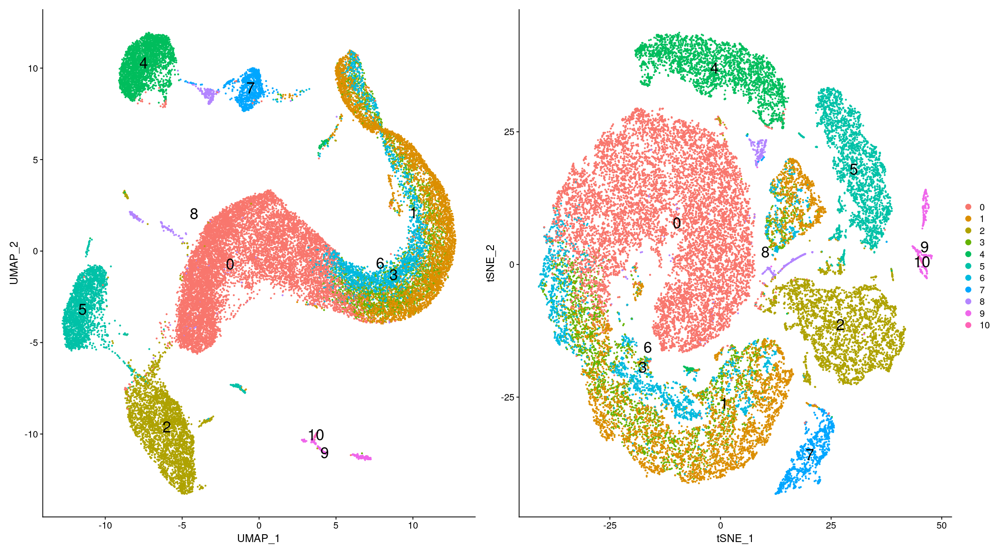

In [347]:
options(repr.plot.height = 10, repr.plot.width = 18)
umap_unlabeled <- DimPlot(cells, reduction = "umap", label = TRUE, pt.size = 0.5, label.size = 7) + NoLegend()
tsne_unlabeled <- DimPlot(cells, reduction = "tsne", label = TRUE, pt.size = 0.5, label.size = 7) 
umap_unlabeled + tsne_unlabeled

In [ ]:
## save 
# saveRDS(ileum, file = "results/ileum_first_umap.rds")

## Finding differentially expressed features (cluster biomarkers)
- Seurat can help you find markers that define clusters via differential expression. 
- By default, it identifies positive and negative markers of a single cluster (specified in ident.1), compared to all other cells.

In [72]:
# The FindAllMarkers() function 
#   (provides) automates this process for all clusters
#     - can also test groups of clusters vs. each other, or against all cells.
#   (min.pct argument)
#     - requires a feature to be detected at a minimum percentage in either of the two groups of cells, and the 
#       thresh.test argument requires a feature to be differentially expressed (on average) by some amount between 
#       the two groups. 
#     - You can set both of these to 0, but with a dramatic increase in time - since this will test a large number 
#       of features that are unlikely to be highly discriminatory. 
#     - As another option to speed up these computations, max.cells.per.ident can be set. #
#     - This will downsample each identity class to have no more cells than whatever this is set to. 
#     - While there is generally going to be a loss in power, the speed increases can be significant and the most 
#       highly differentially expressed features will likely still rise to the top.

In [360]:
# (ex) find markers for every cluster compared to all remaining cells, report only the positive ones
cells.markers <- FindAllMarkers(cells, only.pos = TRUE, min.pct = 0.25, logfc.threshold = 0.25)
cells.markers %>%
    group_by(cluster) %>%
    slice_max(n = 2, order_by = avg_log2FC)

Calculating cluster 0

Calculating cluster 1

Calculating cluster 2

Calculating cluster 3

Calculating cluster 4

Calculating cluster 5

Calculating cluster 6

Calculating cluster 7

Calculating cluster 8

Calculating cluster 9

Calculating cluster 10



p_val,avg_log2FC,pct.1,pct.2,p_val_adj,cluster,gene
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
0.000000e+00,3.371332,0.838,0.172,0.000000e+00,0,Kcnq1
0.000000e+00,2.837977,0.475,0.053,0.000000e+00,0,Dmbt1
0.000000e+00,3.115382,0.586,0.134,0.000000e+00,1,Clca4a
0.000000e+00,2.409967,0.846,0.224,0.000000e+00,1,Slc10a2
0.000000e+00,5.297026,0.912,0.116,0.000000e+00,2,Fcgbp
0.000000e+00,4.530478,0.778,0.056,0.000000e+00,2,Clca1
0.000000e+00,2.461250,0.917,0.335,0.000000e+00,3,Slc13a1
0.000000e+00,1.969850,0.806,0.280,0.000000e+00,3,Rnf152
0.000000e+00,6.059160,0.977,0.037,0.000000e+00,4,Ebf1


In [366]:
# # (ex) find all markers of cluster 2
# cluster2.markers <- FindMarkers(cells, ident.1 = 2, min.pct = 0.25)
# head(cluster2.markers, n = 5)

In [367]:
# # (ex) find all markers distinguishing cluster 5 from clusters 0 and 3
# cluster5.markers <- FindMarkers(cells, ident.1 = 5, ident.2 = c(0, 3), min.pct = 0.25)
# head(cluster5.markers, n = 5)

In [368]:
# # (ex) find all markers distinguishing cluster 12 from clusters 14
# cluster12.markers <- FindMarkers(cells, ident.1 = 12, ident.2 = 14, min.pct = 0.25)
# head(cluster12.markers, n = 5)

In [369]:
# Seurat has several tests for differential expression which can be set with the test.use parameter 
# For example, the ROC test returns the ‘classification power’ for any individual marker 
#   (ranging from 0 - random, to 1 - perfect).

In [370]:
# cluster0.markers <- FindMarkers(cells, ident.1 = 0, logfc.threshold = 0.25, test.use = "roc", only.pos = TRUE)
# head(cluster0.markers, n = 5)

#### Seurat provides several useful ways of visualizing marker expression
- VlnPlot() - shows expression probability distributions across clusters
- FeaturePlot() - visualizes feature expression on a tSNE or PCA plot
- DoHeatmap() - generates an expression heatmap for given cells and features
- RidgePlot()
- CellScatter()
- DotPlot()

In [380]:
best.two.wilcox.genes.per.cluster <- cells.markers %>%
    group_by(cluster) %>%
    slice_max(n = 2, order_by = avg_log2FC) %>%
    pull(gene) 

best.two.wilcox.genes.per.cluster

[1] "Kcnq1"   "Dmbt1"   "Clca4a"  "Slc10a2" "Fcgbp"   "Clca1"   "Slc13a1"
 [8] "Rnf152"  "Ebf1"    "Bank1"   "Lyz1"    "Itln1"   "Plb1"    "Slc5a12"
[15] "Skap1"   "Prkch"   "Kcnb2"   "Slc8a1"  "Prkg1"   "Cacnb2"  "Nkain2" 
[22] "Cdh19"

In [ ]:
# looking top two DEGs per cluster 
options(repr.plot.height = 30, repr.plot.width = 15)
VlnPlot(cells,features=best.two.wilcox.genes.per.cluster)

In [ ]:
# Part 1 of 2
# (source) from Nature paper "Cells of the human intestinal tract mapped across space and time"
#  - (link) https://www.nature.com/articles/s41586-021-03852-1#Sec8
options(repr.plot.height = 30, repr.plot.width = 15)
VlnPlot(cells,
                    features = c(
                                "Lgr5", "Ascl2", "Smoc2", "Rgmb", "Olfm4",    # Stem cells
                                "Defa5", "Defa6", "Reg3a",                    # Paneth
                                "Ta", "Mk167", "Top2a", "Pcna",               # Transit-amplifying
                                "Clca1", "Spdef", "Fcgbp", "Zg16", "Muc2",    # Goblet
                                "Best4", "Otop2", "Ca7",                       # BEST4 enterocyte
                                "Rbp2", "Anpep", "Fabp2",                     # enterocytes
                                "Ca2", "Slc26a2", "Fabp1"                    # colonocytes
                             ))

In [ ]:
# Part 2 of 2
# (source) from Nature paper "Cells of the human intestinal tract mapped across space and time"
#  - (link) https://www.nature.com/articles/s41586-021-03852-1#Sec8
options(repr.plot.height = 30, repr.plot.width = 15)
VlnPlot(cells,
                    features = c(
                                "Chga", "Chgb", "Neurod1",                    # enteroendocrine
                                "Spib", "Ccl20", "Gp2",                       # Microfold cells
                                "Pou2f3", "Irag2", "Trpm5",                   # Tuft cells
                                "Klk15", "Klk3", "Wfdc2", "Wfdc3",            # BEST2 goblet cells
                        
                                "Mln", "Ghrl", "Sst", "Ins", "Gcg", "Nts",    # enteroendocrine cells
                                "Gip", "Cck", "Tph1", "Npw", "Tac1"           # enteroendocrine cells
                        
                             ))

Warning message in FetchData.Seurat(object = object, vars = features, slot = slot):
“The following requested variables were not found: Hba, Mt, Hmgb”


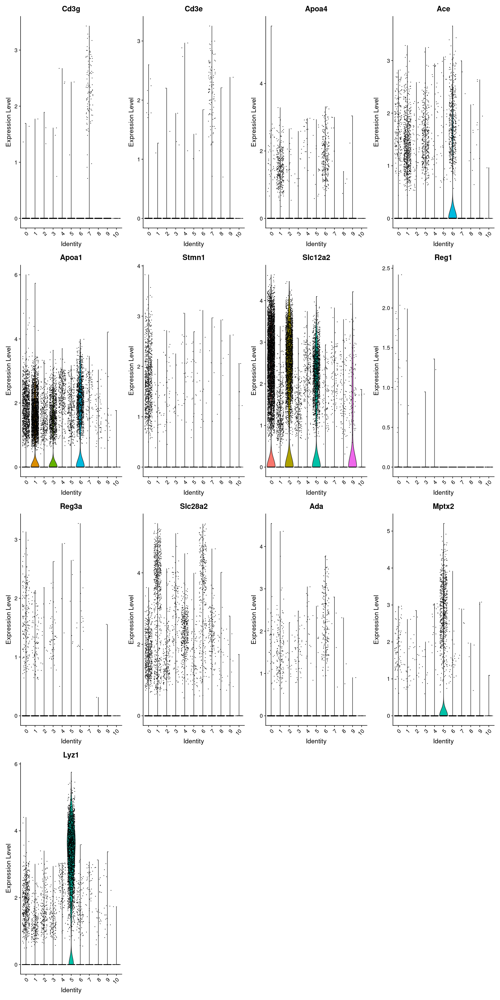

In [384]:
# Part 1 of 2
# (source) from 10X tutorial on intestinal data
#  - (linke) https://support.10xgenomics.com/img/single-cell-gex/gex-analysis-tour-4.png
options(repr.plot.height = 30, repr.plot.width = 15)
VlnPlot(cells, features = c(
                                "Hba",                       # Erythrocytes/ Dying cells
                                # "Mt genes",                  # Dying cells 
                                "Cd3g", "Cd3e",              # Immune cells
                                "Apoa4", "Mt",               # Enterocytes/ Dying cells
                                "Ace","Apoa1",               # Enterocytes
                                "Stmn1", "Hmgb", "Slc12a2",  # CBCs (crypt base columnar cells)
                                "Reg1","Reg3a",              # Enterocytes
                                "Slc28a2","Ada",             # Enterocytes
                                "Mptx2", "Lyz1"             # Paneth cell  
                                # "Mt genes",                  # Dying cells
                          
                             ))

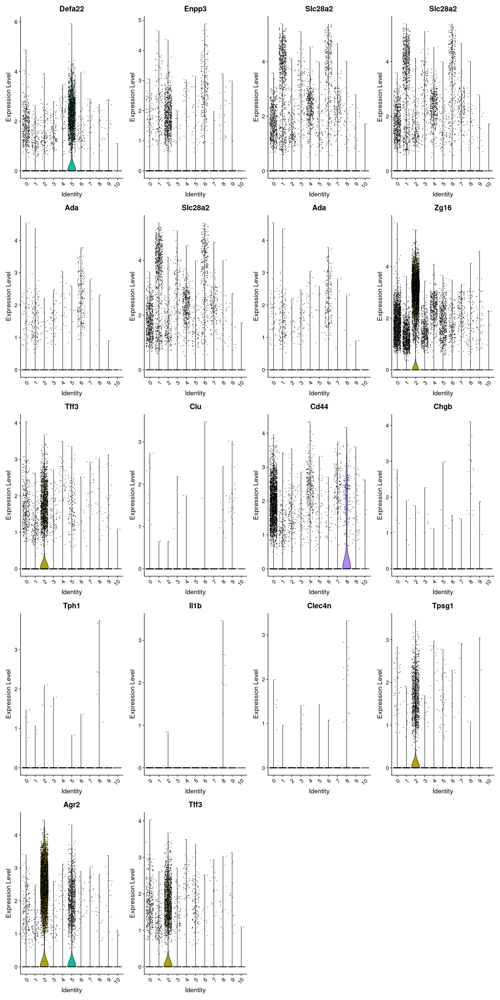

In [385]:
# Part 2 of 2
# (source) from 10X tutorial on intestinal data
#  - (linke) https://support.10xgenomics.com/img/single-cell-gex/gex-analysis-tour-4.png
options(repr.plot.height = 30, repr.plot.width = 15)
VlnPlot(cells,
                    features = c(
                                "Defa22",                    # Paneth cell  
                                "Enpp3","Slc28a2",           # Enterocytes
                                "Slc28a2","Ada",             # Enterocytes
                                "Slc28a2","Ada",             # Enterocytes
                                # "Mt genes",                  # Dying cells
                                "Zg16","Tff3",               # Goblet cells
                                "Clu", "Cd44",               # ?
                                "Chgb", "Tph1",              # Enteroendocrine cells
                                "Il1b", "Clec4n",            # Immune cells
                                "Tpsg1","Agr2","Tff3"        # Goblet cells
                             ))

In [386]:
# you can plot raw counts as well
# VlnPlot(ileum, features = c("NKG7", "PF4"), slot = "counts", log = TRUE)

#### UMAP plot with DGE genes, Nature paper marker genes, and tutorial genes overlayed

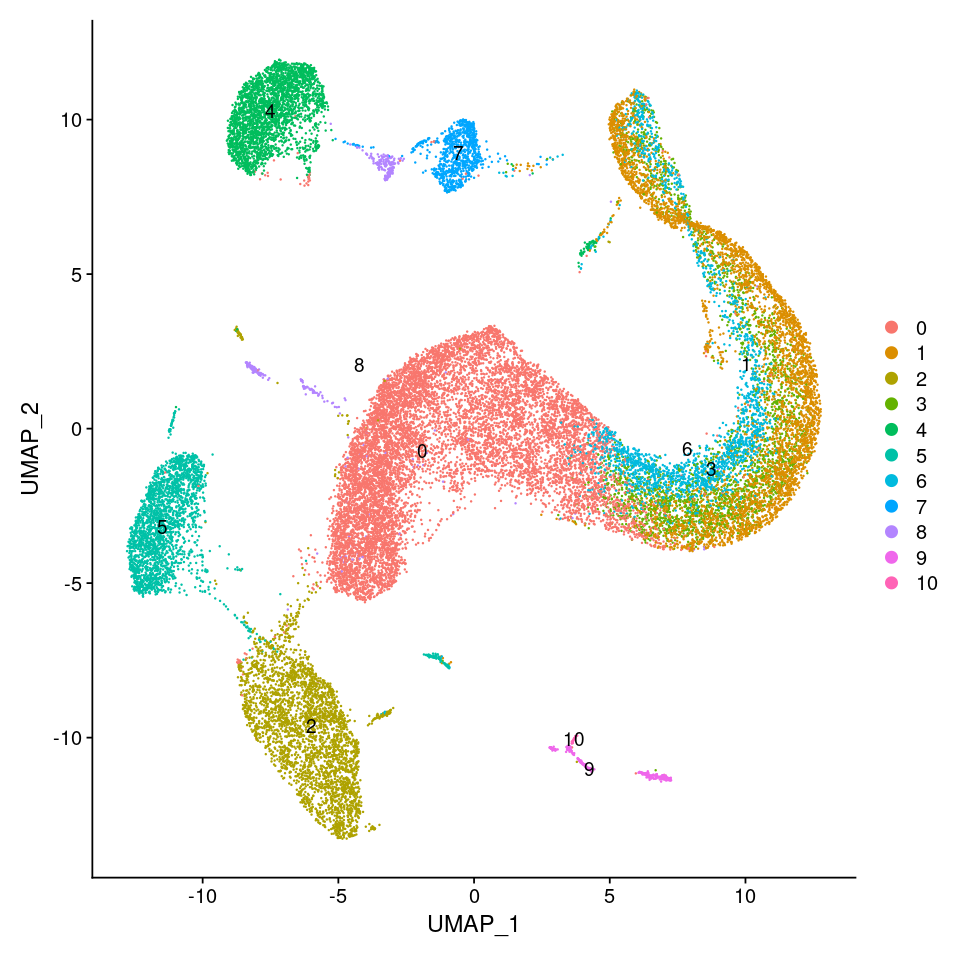

In [387]:
options(repr.plot.height = 8, repr.plot.width = 8)
DimPlot(cells, reduction = "umap", label = TRUE)   # just showing again for quick comparison to next few cells

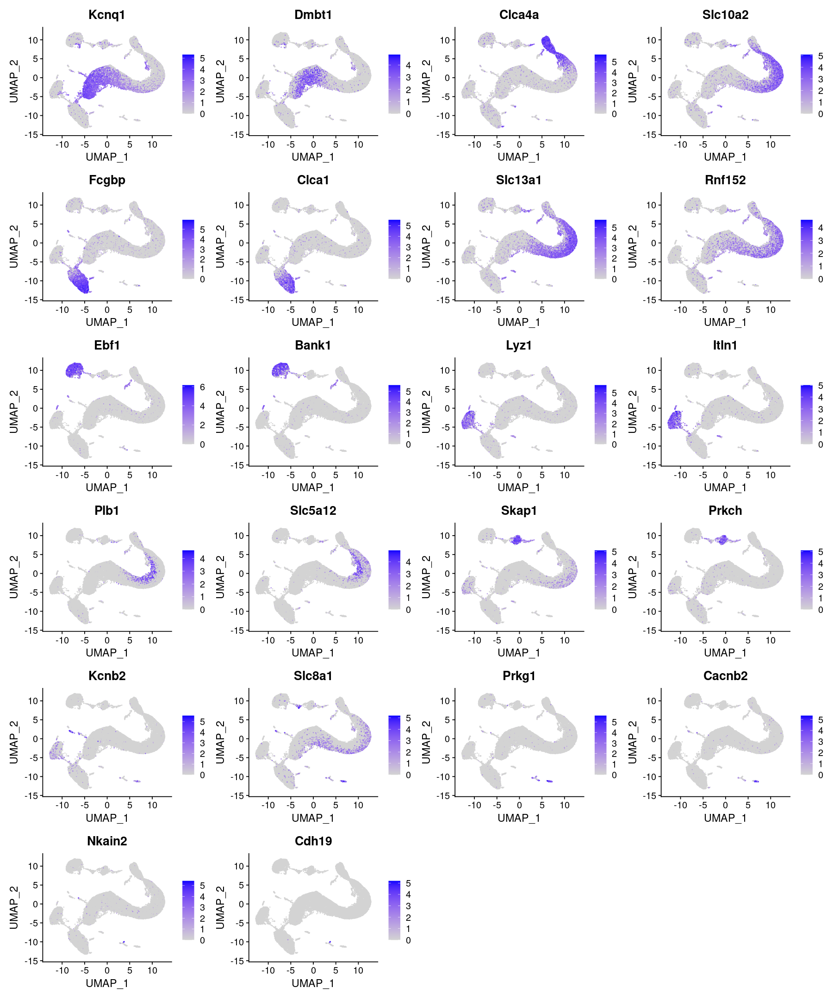

In [388]:
# looking top two DEGs per cluster 
options(repr.plot.height = 18, repr.plot.width = 15)
FeaturePlot(cells, reduction = "umap", features = best.two.wilcox.genes.per.cluster)

Warning message in FetchData.Seurat(object = object, vars = c(dims, "ident", features), :
“The following requested variables were not found: Defa6, Ta, Mk167, Best4, Ca7, Ca2”


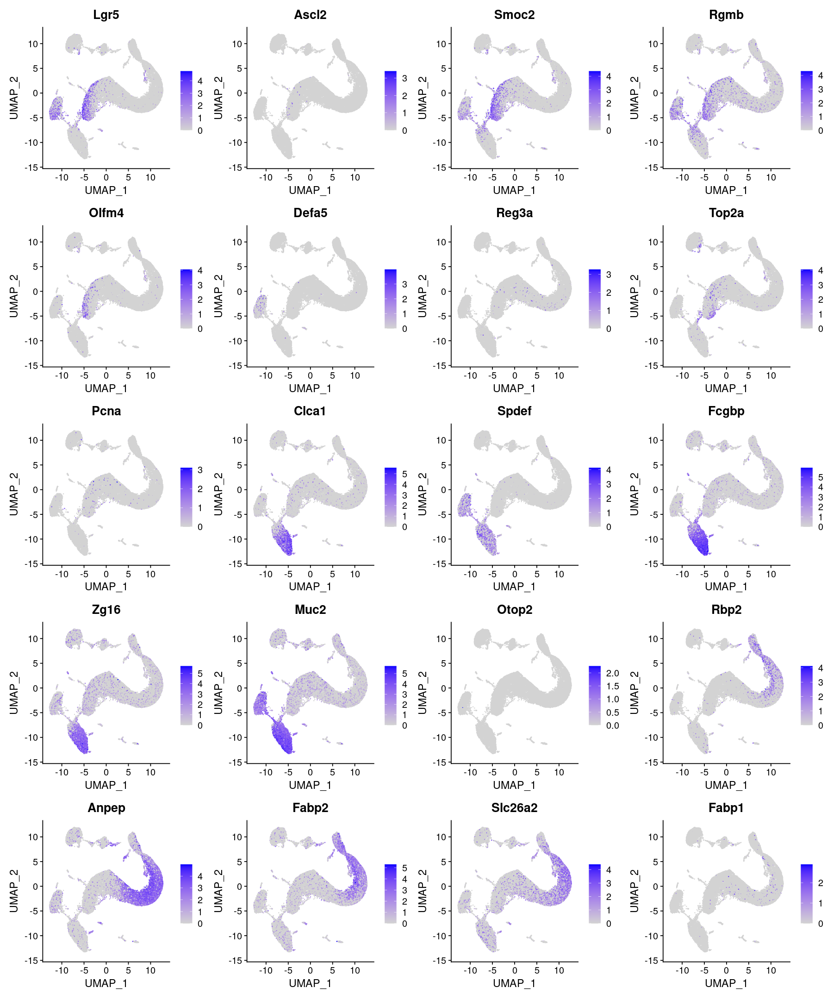

In [391]:
# PART 1 of 2
# (source) from Nature paper "Cells of the human intestinal tract mapped across space and time"
#  - (link) https://www.nature.com/articles/s41586-021-03852-1#Sec8
options(repr.plot.height = 18, repr.plot.width = 15)
FeaturePlot(cells, reduction = "umap",
                    features = c(
                                "Lgr5", "Ascl2", "Smoc2", "Rgmb", "Olfm4",    # Stem cells
                                "Defa5", "Defa6", "Reg3a",                    # Paneth
                                "Ta", "Mk167", "Top2a", "Pcna",               # Transit-amplifying
                                "Clca1", "Spdef", "Fcgbp", "Zg16", "Muc2",    # Goblet
                                "Best4", "Otop2", "Ca7",                       # BEST4 enterocyte
                                "Rbp2", "Anpep", "Fabp2",                     # enterocytes
                                "Ca2", "Slc26a2", "Fabp1"                    # colonocytes
                             ))

Warning message in FetchData.Seurat(object = object, vars = c(dims, "ident", features), :
“The following requested variables were not found: Neurod1, Irag2, Klk15, Klk3, Mln, Ins, Npw”


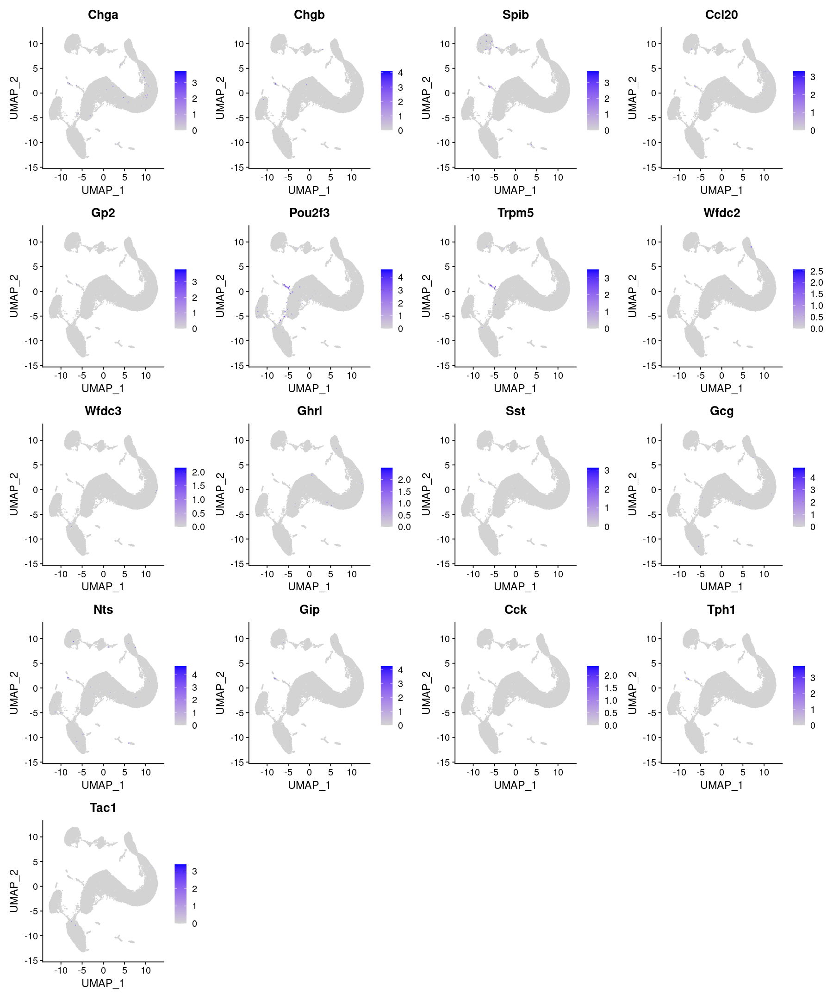

In [392]:
# PART 2 of 2
# (source) from Nature paper "Cells of the human intestinal tract mapped across space and time"
#  - (link) https://www.nature.com/articles/s41586-021-03852-1#Sec8
options(repr.plot.height = 18, repr.plot.width = 15)
FeaturePlot(cells, reduction = "umap",
                    features = c(
                                "Chga", "Chgb", "Neurod1",                    # enteroendocrine
                                "Spib", "Ccl20", "Gp2",                       # Microfold cells
                                "Pou2f3", "Irag2", "Trpm5",                   # Tuft cells
                                "Klk15", "Klk3", "Wfdc2", "Wfdc3",            # BEST2 goblet cells
                        
                                "Mln", "Ghrl", "Sst", "Ins", "Gcg", "Nts",    # enteroendocrine cells
                                "Gip", "Cck", "Tph1", "Npw", "Tac1"           # enteroendocrine cells
                        
                             ))

Warning message in FetchData.Seurat(object = object, vars = c(dims, "ident", features), :
“The following requested variables were not found: Hba, Mt, Hmgb”


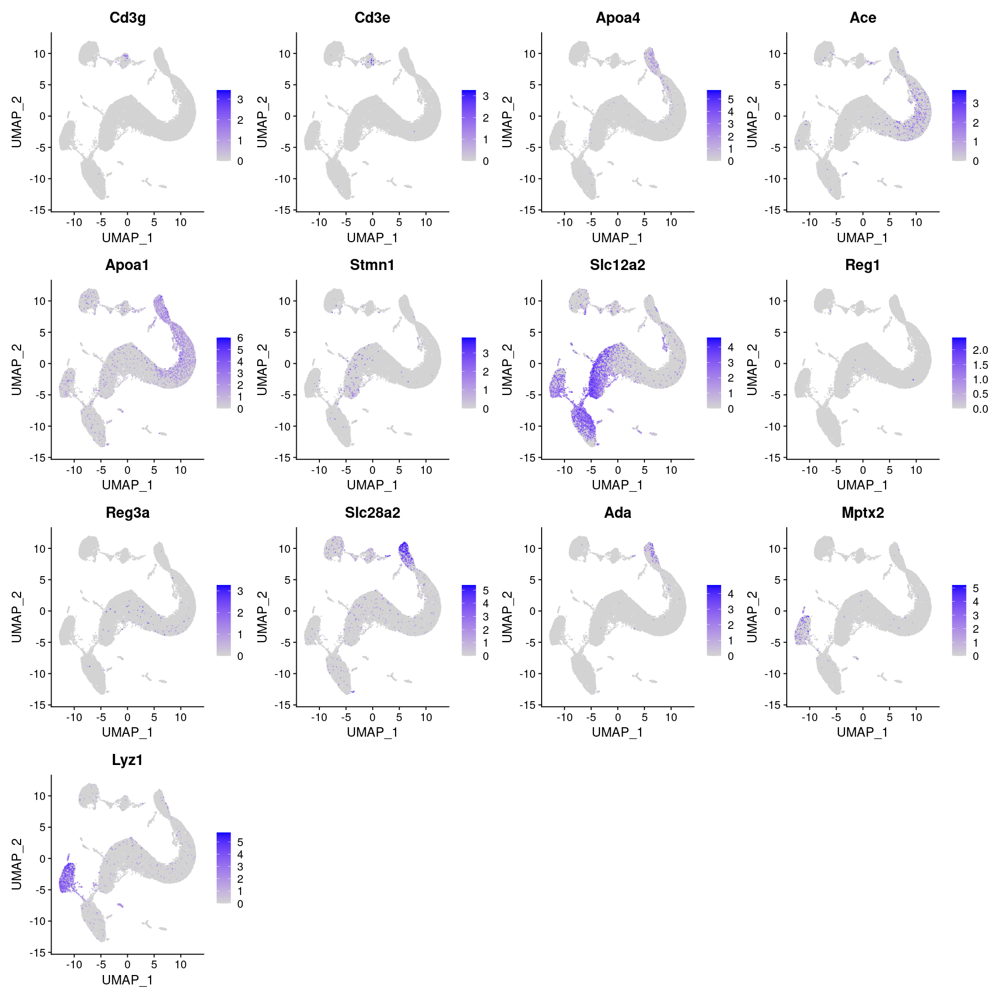

In [393]:
# PART 1 of 2
# (source) from 10X tutorial on intestinal data
#  - (linke) https://support.10xgenomics.com/img/single-cell-gex/gex-analysis-tour-4.png
options(repr.plot.height = 15, repr.plot.width = 15)
FeaturePlot(cells, reduction = "umap",
                    features = c(
                                "Hba",                       # Erythrocytes/ Dying cells
                                # "Mt genes",                  # Dying cells 
                                "Cd3g", "Cd3e",              # Immune cells
                                "Apoa4", "Mt",               # Enterocytes/ Dying cells
                                "Ace","Apoa1",               # Enterocytes
                                "Stmn1", "Hmgb", "Slc12a2",  # CBCs (crypt base columnar cells)
                                "Reg1","Reg3a",              # Enterocytes
                                "Slc28a2","Ada",             # Enterocytes
                                "Mptx2", "Lyz1"             # Paneth cell  
                                # "Mt genes",                  # Dying cells
                          
                             ))

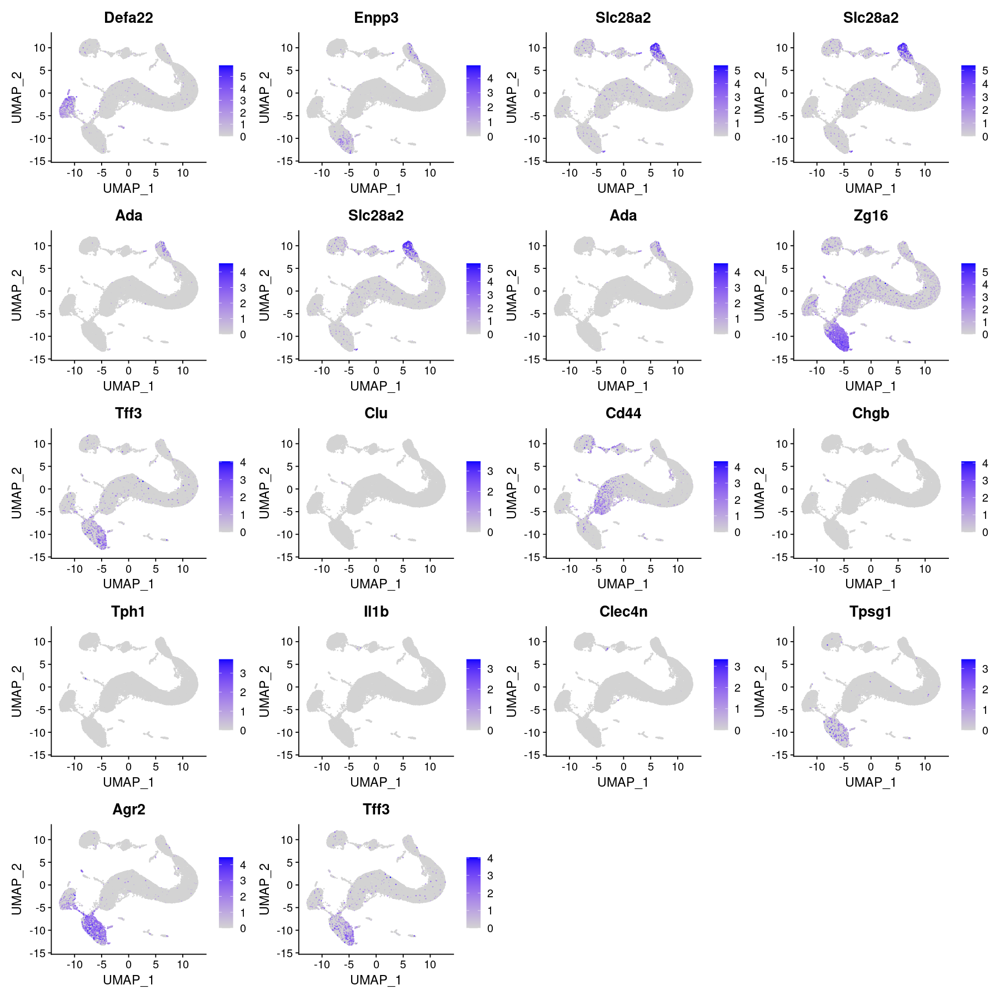

In [394]:
# PART 2 of 2
# (source) from 10X tutorial on intestinal data
#  - (linke) https://support.10xgenomics.com/img/single-cell-gex/gex-analysis-tour-4.png
options(repr.plot.height = 15, repr.plot.width = 15)
FeaturePlot(cells, reduction = "umap",
                    features = c(
                                "Defa22",                    # Paneth cell  
                                "Enpp3","Slc28a2",           # Enterocytes
                                "Slc28a2","Ada",             # Enterocytes
                                "Slc28a2","Ada",             # Enterocytes
                                # "Mt genes",                  # Dying cells
                                "Zg16","Tff3",               # Goblet cells
                                "Clu", "Cd44",               # ?
                                "Chgb", "Tph1",              # Enteroendocrine cells
                                "Il1b", "Clec4n",            # Immune cells
                                "Tpsg1","Agr2","Tff3"        # Goblet cells
                             ))

#### TSNE plot with DGE genes, Nature paper marker genes, and tutorial genes overlayed

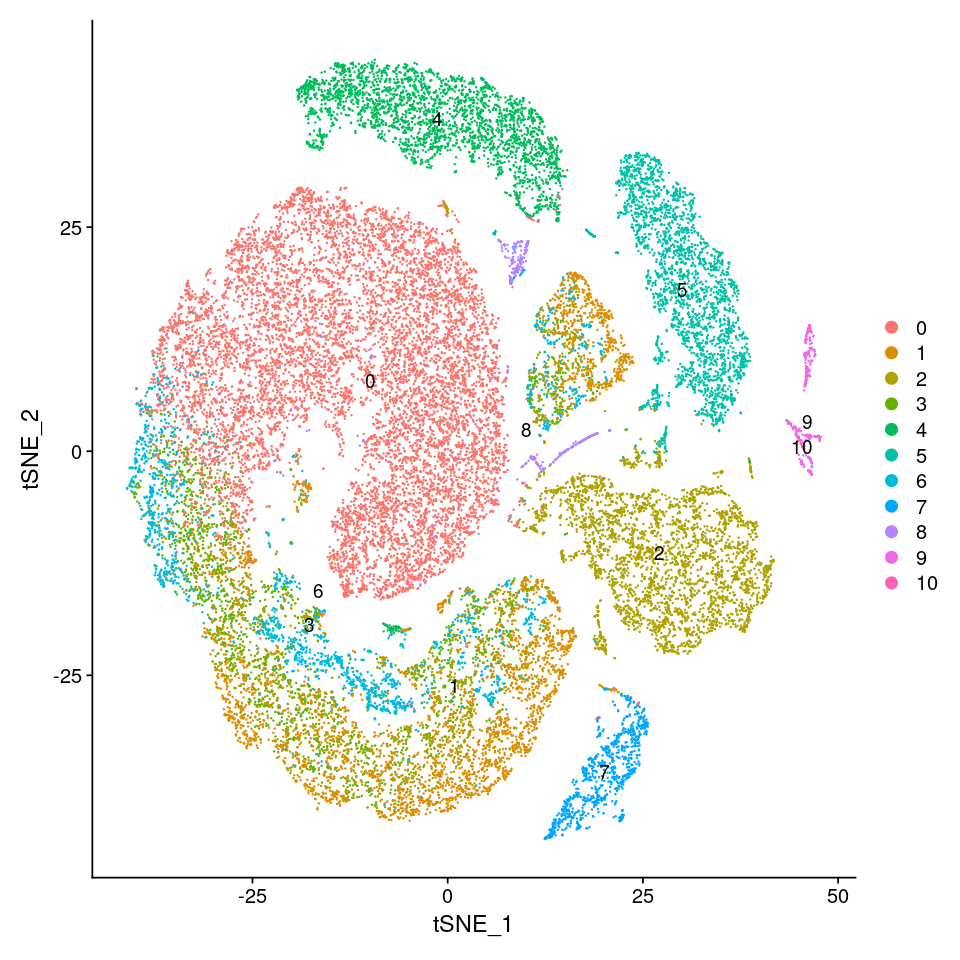

In [395]:
options(repr.plot.height = 8, repr.plot.width = 8)
DimPlot(cells, reduction = "tsne", label = TRUE)

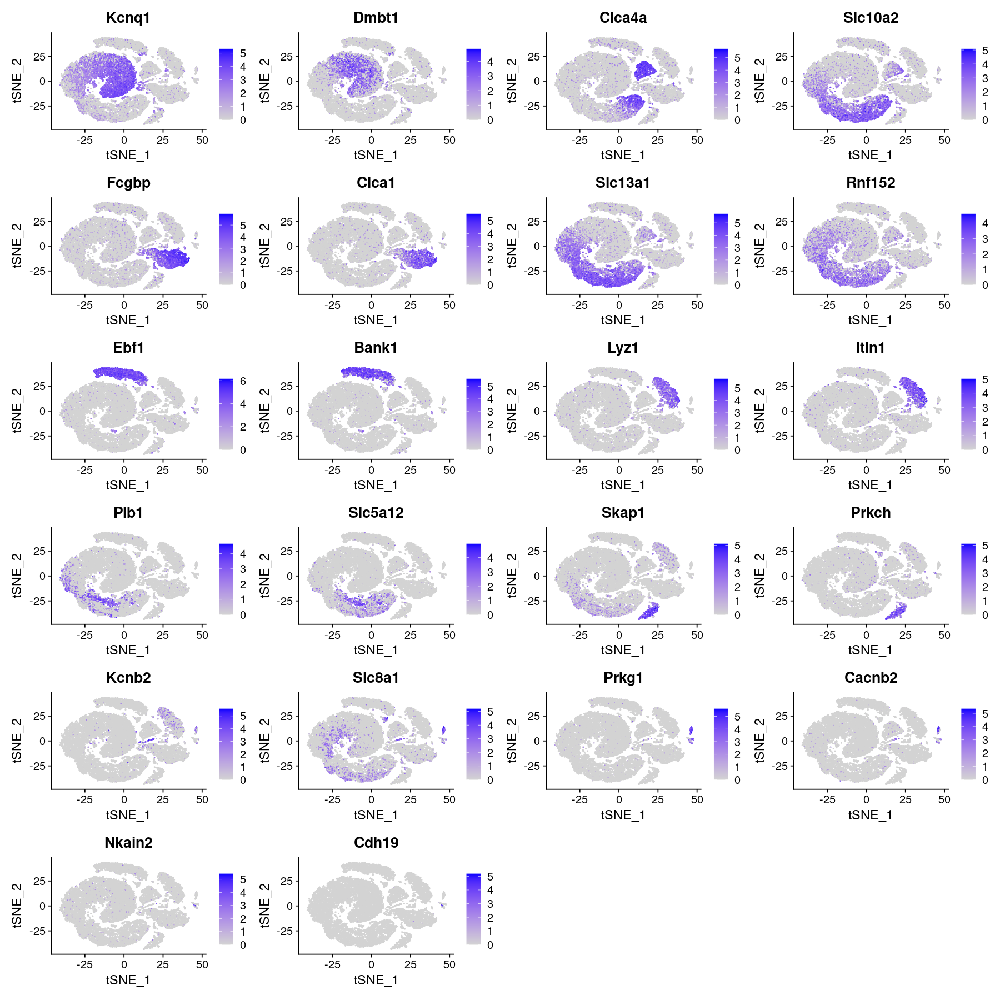

In [396]:
# looking top two DEGs per cluster 
options(repr.plot.height = 15, repr.plot.width = 15)
FeaturePlot(cells, reduction = "tsne", features = best.two.wilcox.genes.per.cluster)

Warning message in FetchData.Seurat(object = object, vars = c(dims, "ident", features), :
“The following requested variables were not found: Defa6, Ta, Mk167, Best4, Ca7, Ca2”


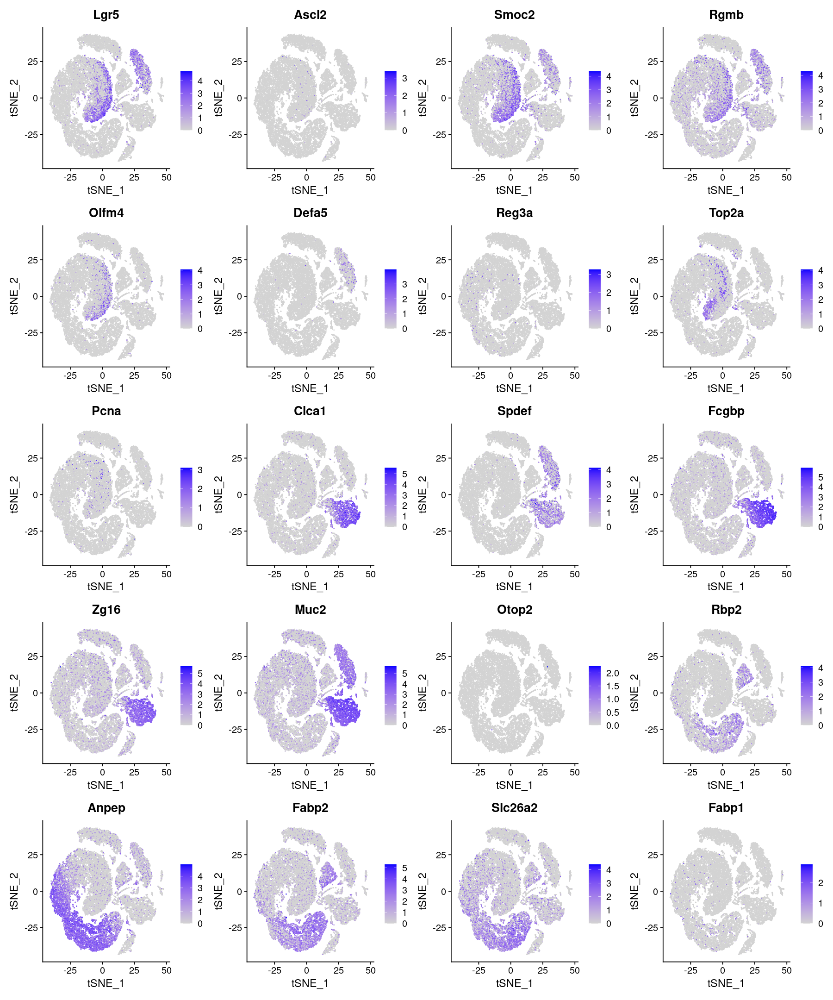

In [397]:
# PART 1 of 2
# (source) from Nature paper "Cells of the human intestinal tract mapped across space and time"
#  - (link) https://www.nature.com/articles/s41586-021-03852-1#Sec8
options(repr.plot.height = 18, repr.plot.width = 15)
FeaturePlot(cells, reduction = "tsne",
                    features = c(
                                "Lgr5", "Ascl2", "Smoc2", "Rgmb", "Olfm4",    # Stem cells
                                "Defa5", "Defa6", "Reg3a",                    # Paneth
                                "Ta", "Mk167", "Top2a", "Pcna",               # Transit-amplifying
                                "Clca1", "Spdef", "Fcgbp", "Zg16", "Muc2",    # Goblet
                                "Best4", "Otop2", "Ca7",                       # BEST4 enterocyte
                                "Rbp2", "Anpep", "Fabp2",                     # enterocytes
                                "Ca2", "Slc26a2", "Fabp1"                    # colonocytes
                               
                             ))

Warning message in FetchData.Seurat(object = object, vars = c(dims, "ident", features), :
“The following requested variables were not found: Neurod1, Irag2, Klk15, Klk3, Mln, Ins, Npw”


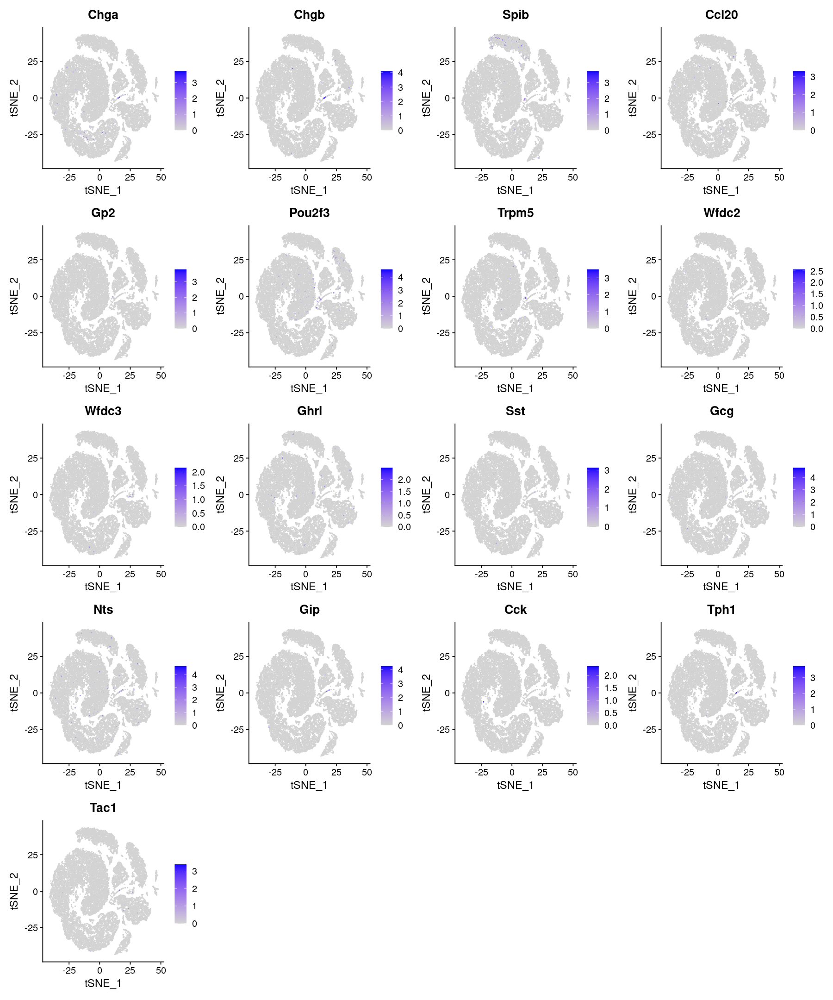

In [398]:
# PART 2 of 2
# (source) from Nature paper "Cells of the human intestinal tract mapped across space and time"
#  - (link) https://www.nature.com/articles/s41586-021-03852-1#Sec8
options(repr.plot.height = 18, repr.plot.width = 15)
FeaturePlot(cells, reduction = "tsne",
                    features = c(
                                "Chga", "Chgb", "Neurod1",                    # enteroendocrine
                                "Spib", "Ccl20", "Gp2",                       # Microfold cells
                                "Pou2f3", "Irag2", "Trpm5",                   # Tuft cells
                                "Klk15", "Klk3", "Wfdc2", "Wfdc3",            # BEST2 goblet cells
                        
                                "Mln", "Ghrl", "Sst", "Ins", "Gcg", "Nts",    # enteroendocrine cells
                                "Gip", "Cck", "Tph1", "Npw", "Tac1"           # enteroendocrine cells
                        
                             ))

Warning message in FetchData.Seurat(object = object, vars = c(dims, "ident", features), :
“The following requested variables were not found: Hba, Mt, Hmgb”


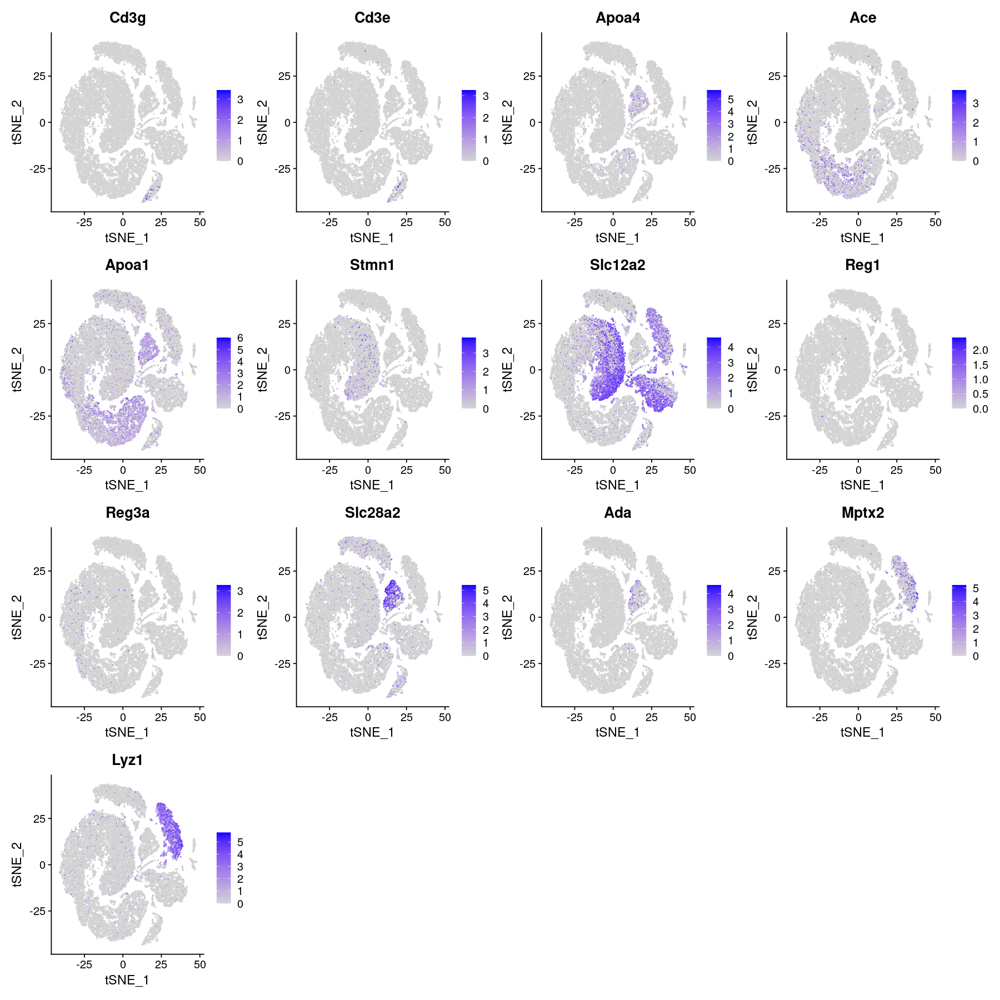

In [399]:
# PART 1 of 2
# (source) from 10X tutorial on intestinal data
#  - (linke) https://support.10xgenomics.com/img/single-cell-gex/gex-analysis-tour-4.png
options(repr.plot.height = 15, repr.plot.width = 15)
FeaturePlot(cells, reduction = "tsne",
                    features = c(
                                "Hba",                       # Erythrocytes/ Dying cells
                                # "Mt genes",                  # Dying cells 
                                "Cd3g", "Cd3e",              # Immune cells
                                "Apoa4", "Mt",               # Enterocytes/ Dying cells
                                "Ace","Apoa1",               # Enterocytes
                                "Stmn1", "Hmgb", "Slc12a2",  # CBCs (crypt base columnar cells)
                                "Reg1","Reg3a",              # Enterocytes
                                "Slc28a2","Ada",             # Enterocytes
                                "Mptx2", "Lyz1"             # Paneth cell  
                                # "Mt genes",                  # Dying cells
                          
                             ))

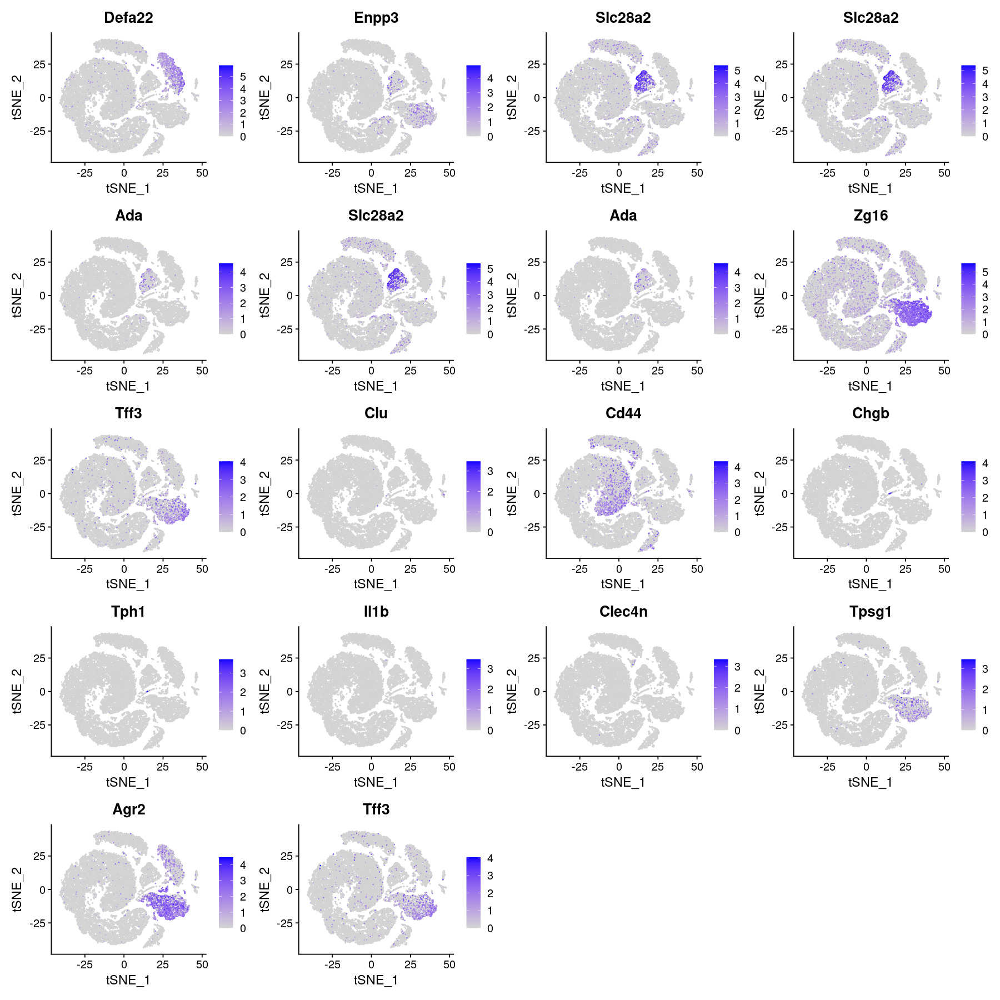

In [400]:
# PART 2 of 2
# (source) from 10X tutorial on intestinal data
#  - (linke) https://support.10xgenomics.com/img/single-cell-gex/gex-analysis-tour-4.png
options(repr.plot.height = 15, repr.plot.width = 15)
FeaturePlot(cells, reduction = "tsne",
                    features = c(
                                "Defa22",                    # Paneth cell  
                                "Enpp3","Slc28a2",           # Enterocytes
                                "Slc28a2","Ada",             # Enterocytes
                                "Slc28a2","Ada",             # Enterocytes
                                # "Mt genes",                  # Dying cells
                                "Zg16","Tff3",               # Goblet cells
                                "Clu", "Cd44",               # ?
                                "Chgb", "Tph1",              # Enteroendocrine cells
                                "Il1b", "Clec4n",            # Immune cells
                                "Tpsg1","Agr2","Tff3"        # Goblet cells
                             ))

#### Other Seurat visuals

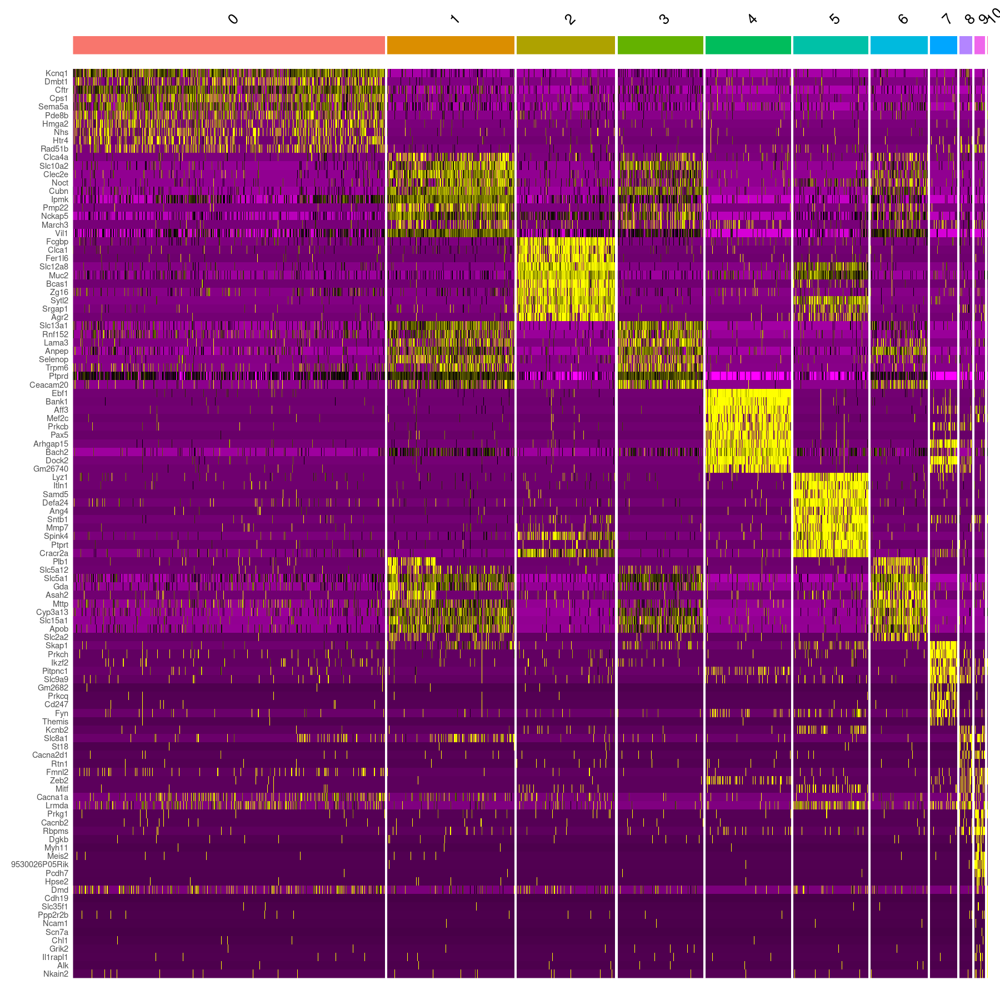

In [401]:
# In this case, we are plotting the top 20 markers (or all markers if less than 20) for each cluster.
cells.markers %>%
    group_by(cluster) %>%
    top_n(n = 10, wt = avg_log2FC) -> top10
DoHeatmap(cells, features = top10$gene) + NoLegend()


## Assigning cell type identity to clusters

#### For case of ileum dataset, we can try cell markers to match the unbiased clusters to known cell types

  
| Cluster ID  | Markers       | Cell Type      | Associated Study |
| ----------- | ------------- | -------------- | ---------------- |
| 0           | Smoc2         | Stem cell      | https://www.ncbi.nlm.nih.gov/pmc/articles/PMC7471277/ |
| 0           | Lgr5          | Stem cell      | https://www.ncbi.nlm.nih.gov/pmc/articles/PMC7332981/ |
| 1           | Fabp2         | Enterocyte     | https://www.ncbi.nlm.nih.gov/pmc/articles/PMC4323920/ |
| 2           | Tff3          | Goblet cell    | https://www.nature.com/articles/s41419-022-04504-6 |
| 2           | Agr2          | Goblet cell    | https://www.sciencedirect.com/science/article/pii/S0012160609013979 |
| 3           | Fabp2         | Enterocyte     | https://www.ncbi.nlm.nih.gov/pmc/articles/PMC4323920/ |
| 4           | Bank1         | B cell         | https://www.mdpi.com/2073-4409/10/5/1184 |
| 4           | Ebf1          | B cell         | https://www.ncbi.nlm.nih.gov/gene?Db=gene&Cmd=DetailsSearch&Term=13591 |
| 5           | Lyz1          | Paneth cell    | https://www.sciencedirect.com/science/article/pii/S1074761320303174 |
| 5           | Mptx2         | Paneth cell    | https://www.ncbi.nlm.nih.gov/pmc/articles/PMC8687451/ |
| 5           | Itln1         | Paneth cell    | https://www.nature.com/articles/s41598-021-94679-3 |
| 6           | Fabp2         | Enterocyte     | https://www.ncbi.nlm.nih.gov/pmc/articles/PMC4323920/ |
| 6           | Ada           | Enterocyte     | https://www.embopress.org/doi/full/10.15252/embr.202256454 |
| 6           | Slc28a2       | Enterocyte     | https://www.cell.com/cell/pdf/S0092-8674(18)31164-4.pdf |
| 7           | Skap1         | T cell         | https://www.ncbi.nlm.nih.gov/pmc/articles/PMC10380396/ | 
| 7           | Prkch         | T cell         | https://www.ncbi.nlm.nih.gov/pmc/articles/PMC3242502/ | 
| 8           | Pou2f3        | Tuft cell      | https://www.ncbi.nlm.nih.gov/pmc/articles/PMC9419707/ |
| 8           | Trpm5         | Tuft cell      | https://onlinelibrary.wiley.com/doi/10.1002/cne.21768 |
| 9           | Prkg1         | Smooth muscle? | https://academic.oup.com/cardiovascres/article/97/2/200/334119 |
| 10          | Cdh19         | Neuron?        | https://www.gastrojournal.org/article/S0016-5085(21)03409-0/pdf |

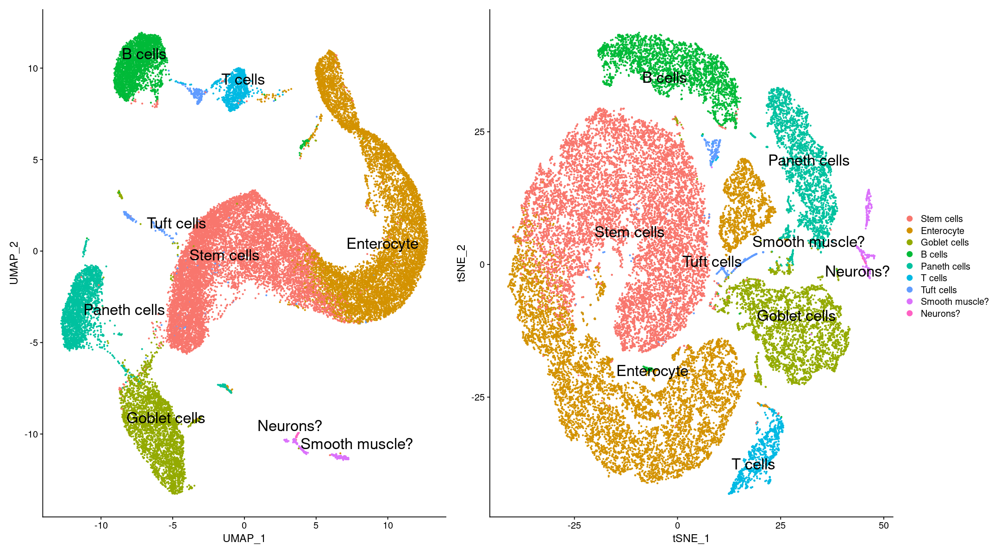

In [402]:
# create a plot that has cluster names included
options(repr.plot.height = 10, repr.plot.width = 18)
new.cluster.ids <- c(
                    "Stem cells",      # cluster0
                    "Enterocyte",      # cluster1
                    "Goblet cells",    # cluster2
                    "Enterocyte",      # cluster3
                    "B cells",         # cluster4
                    "Paneth cells",    # cluster5
                    "Enterocyte",      # cluster6
                    "T cells",         # cluster7
                    "Tuft cells",      # cluster8
                    "Smooth muscle?",  # cluster9
                    "Neurons?"         # cluster10
                )
names(new.cluster.ids) <- levels(cells)
cells_labeled <- RenameIdents(cells, new.cluster.ids)
umap_labeled <- DimPlot(cells_labeled, reduction = "umap", label = TRUE, pt.size = 0.5, label.size = 7, repel=TRUE) + NoLegend()
tsne_labeled <- DimPlot(cells_labeled, reduction = "tsne", label = TRUE, pt.size = 0.5, label.size = 7, repel=TRUE) 
umap_labeled + tsne_labeled

In [403]:
my_marker_genes = c(
                    "Smoc2",
                    "Lgr5",
                    "Fabp2",
                    "Tff3",
                    "Agr2",
                    "Fabp2",
                    "Bank1",
                    "Ebf1",
                    "Lyz1",
                    "Mptx2",
                    "Itln1",
                    "Fabp2",
                    "Ada",
                    "Slc28a2",
                    "Skap1",
                    "Prkch",
                    "Pou2f3",
                    "Trpm5",
                    "Prkg1",
                    "Cdh19"
                    )

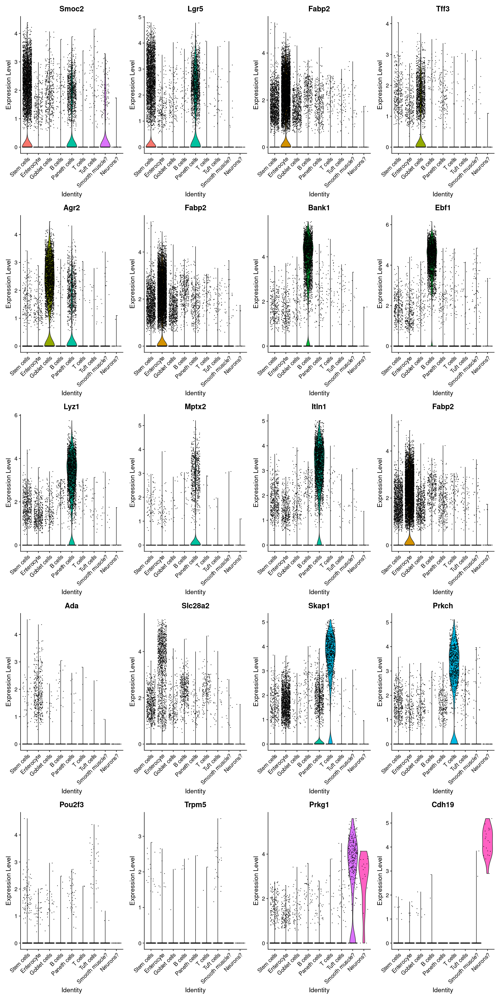

In [404]:
# looking my guess of marker genes
options(repr.plot.height = 30, repr.plot.width = 15)
VlnPlot(cells_labeled,features=my_marker_genes)

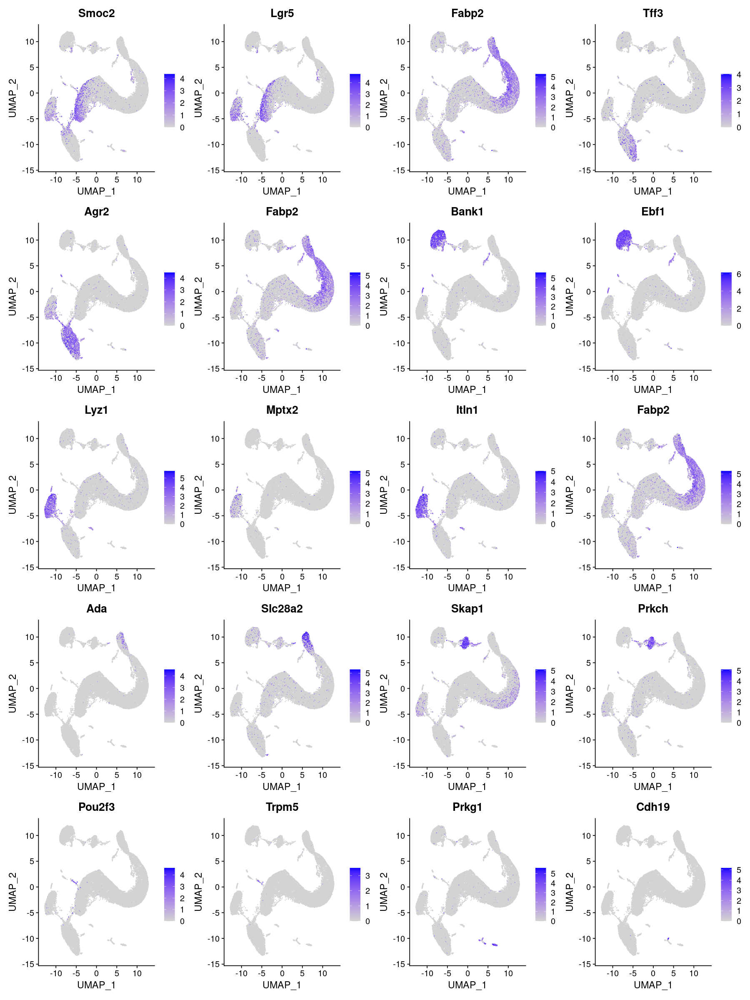

In [405]:
# looking my guess of marker genes
options(repr.plot.height = 20, repr.plot.width = 15)
FeaturePlot(cells_labeled, reduction = "umap", features = my_marker_genes)

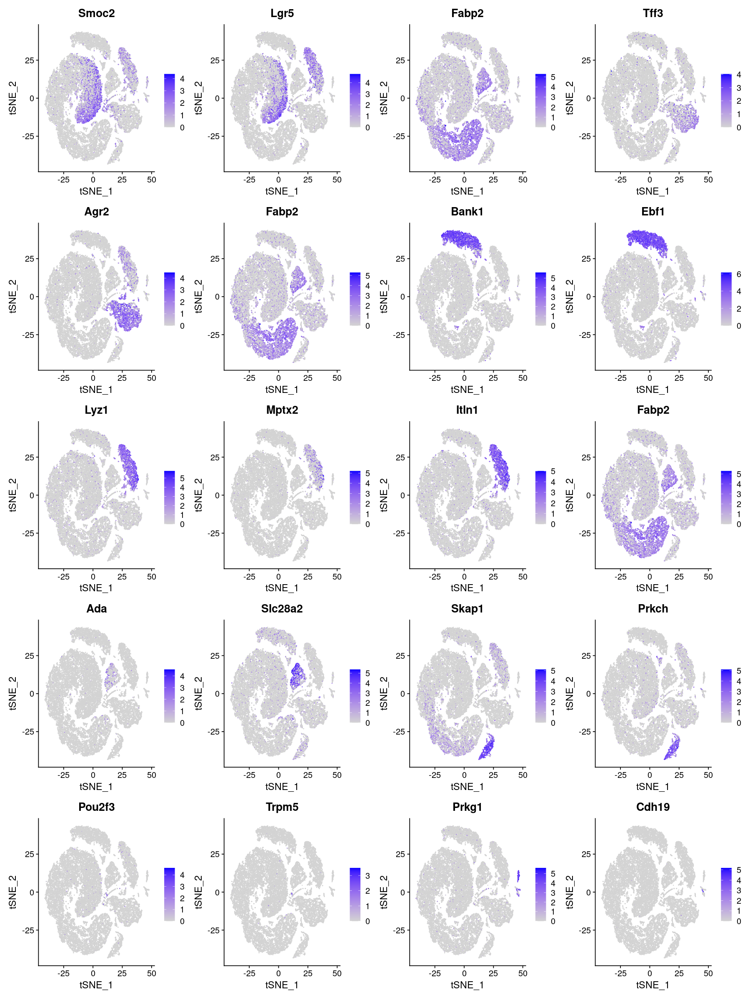

In [406]:
# looking my guess of marker genes
options(repr.plot.height = 20, repr.plot.width = 15)
FeaturePlot(cells_labeled, reduction = "tsne", features = my_marker_genes)

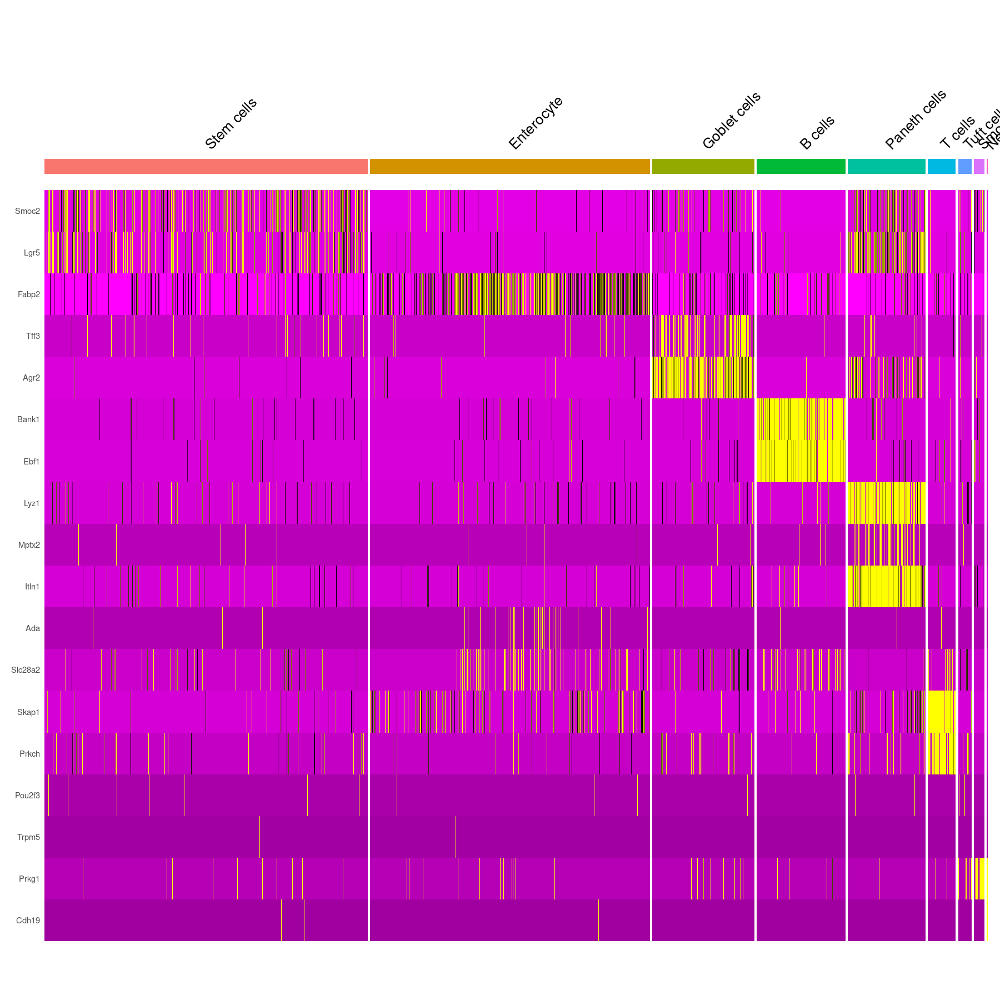

In [407]:
# looking my guess of marker genes
options(repr.plot.height = 15, repr.plot.width = 15)
DoHeatmap(cells_labeled, features = my_marker_genes) + NoLegend()


In [168]:
## save
# saveRDS(pbmc, file = "results/pbmc3k_final.rds")

In [408]:
## Create Loupe file for Cloupe browser
create_loupe_from_seurat(cells_labeled,
                             output_dir="results/",
                             output_name="10xIleum_cloupeFile_20230927"
                        )

2023/09/27 10:11:42 extracting matrix, clusters, and projctions

2023/09/27 10:11:42 selected assay: RNA

2023/09/27 10:11:42 selected clusters: active_cluster orig.ident samples groups RNA_snn_res.0.1 seurat_clusters

2023/09/27 10:11:42 selected projections: umap tsne

2023/09/27 10:11:42 validating count matrix

2023/09/27 10:11:42 validating clusters

2023/09/27 10:11:42 validating projections



# Differential Expression Analysis on the two conditions of these samples
- (source) https://www.bioconductor.org/packages/release/bioc/vignettes/muscat/inst/doc/analysis.html#starting-point
- (samples) 
    * JB_1192: F/F 7264
    * JB_1193: F/F Vil Cre 7282
    * JB_1194: F/F 7272
    * JB_1195: F/F Vil Cre 7250
- the difference between the wildtype samples (JB_1192 and JB_1194) versus the mutant samples (JB_1193 and JB_1195) are that the mutant samples have a knockdown of the Ipmk gene.

## Prepare the data for the `muscat` package which handles multi-sample multi-condition data
- (source) https://bioconductor.org/packages/release/bioc/vignettes/SingleCellExperiment/inst/doc/intro.html

In [436]:
cells_labeled

An object of class Seurat 
22309 features across 29706 samples within 1 assay 
Active assay: RNA (22309 features, 2000 variable features)
 3 dimensional reductions calculated: pca, umap, tsne

In [437]:
# converting from a Seurat object to a SingleCellExperiment object
sce <- as.SingleCellExperiment(cells_labeled)
sce

class: SingleCellExperiment 
dim: 22309 29706 
metadata(0):
assays(3): counts logcounts scaledata
rownames(22309): Xkr4 Gm1992 ... CAAA01118383.1 CAAA01147332.1
rowData names(0):
colnames(29706): AAACCCAAGACTTCGT-1 AAACCCAAGGCGATAC-1 ...
  TTTGTTGTCGACCCAG-4 TTTGTTGTCGCCTTTG-4
colData names(9): orig.ident nCount_RNA ... seurat_clusters ident
reducedDimNames(3): PCA UMAP TSNE
mainExpName: RNA
altExpNames(0):

In [438]:
# preview the colData which contains metadata info we will need such as "samples,groups"
colData(sce)

DataFrame with 29706 rows and 9 columns
                   orig.ident nCount_RNA nFeature_RNA     samples      groups
                     <factor>  <numeric>    <integer> <character> <character>
AAACCCAAGACTTCGT-1  10x_ileum       1987         1237     JB_1192    wildtype
AAACCCAAGGCGATAC-1  10x_ileum       4086         1894     JB_1192    wildtype
AAACGAACAGTCGGTC-1  10x_ileum       1165          811     JB_1192    wildtype
AAACGAAGTAGGCAAC-1  10x_ileum        529          438     JB_1192    wildtype
AAACGAAGTCGACTTA-1  10x_ileum       3405         1751     JB_1192    wildtype
...                       ...        ...          ...         ...         ...
TTTGTTGCATCTAGAC-4  10x_ileum       7119         2884     JB_1195      mutant
TTTGTTGGTCTGCAAT-4  10x_ileum       5229         2430     JB_1195      mutant
TTTGTTGTCAGACCGC-4  10x_ileum       3095         1476     JB_1195      mutant
TTTGTTGTCGACCCAG-4  10x_ileum       8402         2784     JB_1195      mutant
TTTGTTGTCGCCTTTG-4  10x_

## Data preparation of SingleCellExperiment variable
- muscat expects a certain format of the input SCE. Specifically, the following cell metadata (colData) columns have to be provided:
    * "sample_id": unique sample identifiers (e.g., PeterPan_ref1, Nautilus_trt3, …)
    * "cluster_id": subpopulation (cluster) assignments (e.g., T cells, monocytes, …)
    * "group_id": experimental group/condition (e.g., control/treatment, healthy/diseased, …)

In [439]:
sce$id <- paste0(sce$groups, sce$samples)
sce <- prepSCE(sce, 
                    kid = "ident", # subpopulation assignments
                    gid = "groups",  # group IDs (ctrl/stim)
                    sid = "id",   # sample IDs (ctrl/stim.1234)
                    drop = TRUE)  # drop all other colData columns
sce

class: SingleCellExperiment 
dim: 22309 29706 
metadata(1): experiment_info
assays(3): counts logcounts scaledata
rownames(22309): Xkr4 Gm1992 ... CAAA01118383.1 CAAA01147332.1
rowData names(0):
colnames(29706): AAACCCAAGACTTCGT-1 AAACCCAAGGCGATAC-1 ...
  TTTGTTGTCGACCCAG-4 TTTGTTGTCGCCTTTG-4
colData names(3): cluster_id sample_id group_id
reducedDimNames(3): PCA UMAP TSNE
mainExpName: RNA
altExpNames(0):

In [440]:
# preview the colData again which should be prepared for muscat
colData(sce)

DataFrame with 29706 rows and 3 columns
                     cluster_id       sample_id group_id
                       <factor>        <factor> <factor>
AAACCCAAGACTTCGT-1 Stem cells   wildtypeJB_1192 wildtype
AAACCCAAGGCGATAC-1 Enterocyte   wildtypeJB_1192 wildtype
AAACGAACAGTCGGTC-1 Goblet cells wildtypeJB_1192 wildtype
AAACGAAGTAGGCAAC-1 Stem cells   wildtypeJB_1192 wildtype
AAACGAAGTCGACTTA-1 Enterocyte   wildtypeJB_1192 wildtype
...                         ...             ...      ...
TTTGTTGCATCTAGAC-4 Stem cells     mutantJB_1195   mutant
TTTGTTGGTCTGCAAT-4 Stem cells     mutantJB_1195   mutant
TTTGTTGTCAGACCGC-4 Goblet cells   mutantJB_1195   mutant
TTTGTTGTCGACCCAG-4 Enterocyte     mutantJB_1195   mutant
TTTGTTGTCGCCTTTG-4 Stem cells     mutantJB_1195   mutant

In [441]:
### Looking at cluster-sample sizes; # nb. of cells per cluster-sample
t(table(sce$cluster_id, sce$sample_id))

                 
                  Stem cells Enterocyte Goblet cells B cells Paneth cells
  mutantJB_1193         2726       1629          804    1256          669
  mutantJB_1195         2917       2644          956     666          616
  wildtypeJB_1192       2749       2705          987      46          554
  wildtypeJB_1194       1999       2009          542     879          667
                 
                  T cells Tuft cells Smooth muscle? Neurons?
  mutantJB_1193       298        125             77        6
  mutantJB_1195       228        169            114        6
  wildtypeJB_1192      99         51             89        4
  wildtypeJB_1194     267         82             67        4

## Begin 'muscat' Differential State (DS) Analysis
- To test for state changes across conditions, we will consider two types of approaches:
    * i) mixed models that act directly on cell-level measurements; and
    * ii) aggregation-based methods that act on pseudobulk data.
- For both approaches, each gene is tested for state changes in each cluster.
    * Thus, a total of #(genes)×#(clusters) tests will be performed per comparison of interest.
- The following schematic summarizes the data representation considered by cell- and sample-level approaches, respectively:

<img src="img/SchematicOverviewOfDiffentialStateAnalysis.png" alt="isolated" width="500"/>

- Schematic overview of cell- and sample-level approaches for DS analysis
    * Top panels show a schematic of the data distributions or aggregates across samples
        + each violin is a group or sample
        + each dot is a sample
        + conditions (blue or orange)
    * The bottom panels highlight the data organization in sub-matrix slices of the original count table.

### Aggregation of single-cell to pseudobulk data
- we first aggregate measurements for each sample (in each cluster) to obtain pseudobulk data
    * this allows us to leverage existing bulk RNA-Seq DE frameworks (edgeR, DESeq2, limma)
- In general, aggregateData() will aggregate the data by the colData variables specified with argument by, and return a SingleCellExperiment containing pseudobulk data.
- For DS analysis, measurements must be aggregated at the cluster-sample level (default by = c("cluster_id", "sample_id").
    * In this case, the returned SingleCellExperiment will contain one assay per cluster, where rows = genes and columns = samples.
    * Arguments assay and fun specify the input data and summary statistic, respectively, to use for aggregation.
    * While, in principle, various combinations of input data (raw/(log-)normalized counts, CPM ect.) and summary statistics (sum, mean, median) could be applied, we here default to the sum of raw counts:

In [443]:
pb <- aggregateData(sce,
    assay = "counts", fun = "sum",
    by = c("cluster_id", "sample_id"))
# one sheet per subpopulation
assayNames(pb)

[1] "Stem cells"     "Enterocyte"     "Goblet cells"   "B cells"       
[5] "Paneth cells"   "T cells"        "Tuft cells"     "Smooth muscle?"
[9] "Neurons?"

In [444]:
# pseudobulks for 1st subpopulation
t(head(assay(pb)))

,Xkr4,Gm1992,Gm37381,Rp1,Mrpl15,Lypla1
mutantJB_1193,307,4,0,1,399,3
mutantJB_1195,842,10,1,9,543,1
wildtypeJB_1192,63,2,0,7,412,3
wildtypeJB_1194,96,2,0,5,203,2


### Pseudobulk-level MDS plot
- Prior to conducting any formal testing, we can compute a multi-dimensional scaling (MDS) plot of aggregated signal to explore overall sample similarities.
- 'pbMDS' takes as input any SCE containg PB data as returned by aggregateData, and computes MDS dimensions using edgeR.
    * Ideally, such a representation of the data should separate both clusters and groups from one another.
    * Vice versa, samples from the same cluster or group should cluster together.
- Each point represents a cluster-sample instance; points are colored by cluster ID and shaped by group ID.

Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.


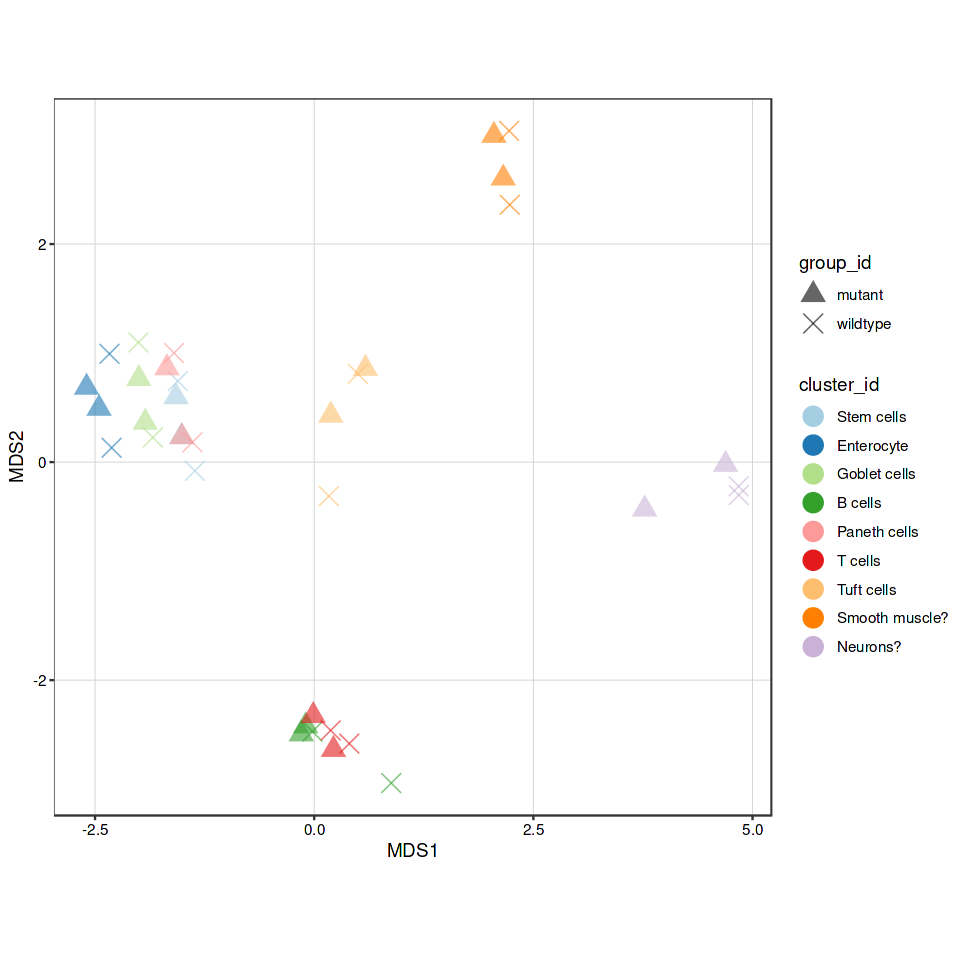

In [452]:
options(repr.plot.height = 8, repr.plot.width = 8)
pb_mds <- pbMDS(pb)

# use very distinctive shaping of groups & change cluster colors
pb_mds <- pb_mds + 
  scale_shape_manual(values = c(17, 4)) +
  scale_color_brewer(palette="Paired")

# change point size & alpha
pb_mds$layers[[1]]$aes_params$size <- 5
pb_mds$layers[[1]]$aes_params$alpha <- 0.6
pb_mds

### Sample-level analysis: Pseudobulk methods
- Once we have assembled the pseudobulk data, we can test for DS using pbDS.
- By default, a '∼group_id' model is fit, and the last coefficient of the linear model is tested to be equal to zero.

In [454]:
# run DS analysis
res <- pbDS(pb, verbose = TRUE)

# access results table for 1st comparison
tbl <- res$table[[1]]

# one data.frame per cluster
names(tbl)

  |======================================================================| 100%



[1] "Stem cells"     "Enterocyte"     "Goblet cells"   "Paneth cells"  
[5] "Tuft cells"     "Smooth muscle?"

In [457]:
# view results for 1st cluster
k1 <- tbl[[1]]
dim(k1)
head(format(k1[, -ncol(k1)], digits = 2))

[1] 12870     9

,gene,cluster_id,logFC,logCPM,F,p_val,p_adj.loc,p_adj.glb
,<I<chr>>,<I<chr>>,<I<chr>>,<I<chr>>,<I<chr>>,<I<chr>>,<I<chr>>,<I<chr>>
1,Xkr4,Stem cells,-2.0e+00,5.55,1.5e+01,7.8e-03,0.99859,0.99297
2,Mrpl15,Stem cells,-5.7e-02,5.99,1.1e-01,7.5e-01,0.99859,0.99646
3,Gm37988,Stem cells,5.6e-01,4.65,6.0e+00,4.9e-02,0.99859,0.99297
4,Tcea1,Stem cells,-2.0e-01,5.08,1.2e+00,3.2e-01,0.99859,0.99297
5,Rgs20,Stem cells,-2.8e-01,1.49,1.9e-01,6.8e-01,0.99859,0.99406
6,Atp6v1h,Stem cells,-2.6e-01,6.70,1.4e+00,2.8e-01,0.99859,0.99297


### [NOT USING] Cell-level analysis: Mixed models

Alternative to the above sample-level approach, we fit (for each gene) a mixed model (MM) to the cell-level measurement data. muscat provides implementations of MM that use 3 main approaches:

- fitting linear mixed models (LMMs) on log-normalized data with observational weights,
- fitting LMMs on variance-stabilized data; and,
- fitting generalized linear mixed models (GLMMs) directly on counts

In each case, a ∼1+group_id+(1|sample_id) model is fit for each gene, optimizing the log-likelihood (i.e., REML = FALSE). 
- P-values are calculated using the estimates of degrees of freedom specifying by argument df (default "Satterthwaite").
- Fitting, testing and moderation are applied subpopulation-wise.
    * For differential testing, mmDS will only consider:
        + subpopulations with at least n_cells cells (default 10) in at least n_samples samples (default 2)
        + genes with a count >= min_count (default 1) in at least min_cells (default 20)

Mixed model based approaches can be run directly on cell-level measurements, and do not require prior aggregation:

In [ ]:
# # 1st approach
# mm <- mmDS(sce, method = "dream",
#   n_cells = 10, n_samples = 2,
#   min_counts = 1, min_cells = 20)

# # 2nd & 3rd approach
# mm <- mmDS(sce, method = "vst", vst = "sctransform")
# mm <- mmDS(sce, method = "nbinom")

## Handling differential testing results
- To get a general overview of the differential testing results, we first filter them:
    * to retain hits FDR < 5% and abs(logFC) > 1, and
    * count the number and frequency of differential findings by cluster.
- Finally, we can view the top hits (lowest adj. p-value) in each cluster.

### Results filtering and overview

In [464]:
# filter FDR < 5%, abs(logFC) > 1 & sort by adj. p-value
tbl_fil <- lapply(tbl, function(u) {
  u <- dplyr::filter(u, p_adj.loc < 0.05, abs(logFC) > 1)
  dplyr::arrange(u, p_adj.loc)
})

In [465]:
# nb. of Differential State (DS) genes & % of total by cluster
n_de <- vapply(tbl_fil, nrow, numeric(1))
p_de <- format(n_de / nrow(sce) * 100, digits = 3)
data.frame("#DS" = n_de, "%DS" = p_de, check.names = FALSE)

,#DS,%DS
,<dbl>,<chr>
Stem cells,8,0.03586
Enterocyte,8,0.03586
Goblet cells,10,0.04482
Paneth cells,11,0.04931
Tuft cells,0,0.00000
Smooth muscle?,1,0.00448


In [468]:
# view top 2 hits in each cluster
top <- bind_rows(lapply(tbl_fil, top_n, 11, p_adj.loc))
format(top[, -ncol(top2)], digits = 2)

,gene,cluster_id,logFC,logCPM,F,p_val,p_adj.loc,p_adj.glb
,<I<chr>>,<I<chr>>,<I<chr>>,<I<chr>>,<I<chr>>,<I<chr>>,<I<chr>>,<I<chr>>
1,Xist,Stem cells,-11.7,11.3,951,6.3e-08,7.7e-04,8.5e-04
2,Uty,Stem cells,9.2,7.6,767,1.2e-07,7.7e-04,1.3e-03
3,Ddx3y,Stem cells,7.4,5.8,611,2.4e-07,1.0e-03,2.0e-03
4,Tsix,Stem cells,-7.5,7.4,397,8.8e-07,1.9e-03,2.9e-03
5,Kdm5d,Stem cells,9.9,5.9,412,7.9e-07,1.9e-03,2.9e-03
6,Eif2s3y,Stem cells,12.9,6.3,865,6.9e-07,1.9e-03,2.7e-03
7,AC121788.1,Stem cells,4.9,4.4,243,3.8e-06,7.1e-03,8.7e-03
8,Mt1,Stem cells,3.4,6.7,144,1.8e-05,2.9e-02,3.1e-02
9,Xist,Enterocyte,-14.3,9.6,818,6.5e-07,3.9e-03,2.7e-03


In [ ]:
# Look for specific genes we are interested in

In [498]:
tbl_fil_specific <- lapply(tbl, function(u) {
  u <- dplyr::filter(u, gene == "Dsc2")
  dplyr::arrange(u, p_adj.loc)
})

In [499]:
# view the genes
top <- bind_rows(lapply(tbl_fil_specific, top_n, 11, p_adj.loc))
format(top[, -ncol(top)], digits = 2)

,gene,cluster_id,logFC,logCPM,F,p_val,p_adj.loc,p_adj.glb
,<I<chr>>,<I<chr>>,<I<chr>>,<I<chr>>,<I<chr>>,<I<chr>>,<I<chr>>,<I<chr>>
1,Dsc2,Stem cells,-0.038,7.2,0.0442,0.84,1.00,1.00
2,Dsc2,Enterocyte,0.255,7.5,1.6531,0.25,0.77,0.99
3,Dsc2,Goblet cells,0.012,6.1,0.0047,0.95,1.00,1.00
4,Dsc2,Paneth cells,-0.122,6.3,0.4127,0.54,1.00,0.99
5,Dsc2,Tuft cells,-0.032,6.7,0.0063,0.94,1.00,1.00


## Visualizing results

### Between-cluster concordance
- DS analysis aims at identifying population-specific changes in state (or expression) across conditions.
- In this setting, key questions of interest arise,
    * e.g., Which genes are DE in only a single (or very few) clusters?
    * e.g., How many DE genes are shared between clusters?
- In summary, what is the general concordance in differential findings between clusters?
- To gain an impression of the between-cluster (dis-)agreement on DE genes:
    * we generate an UpSet-plot that visualizes the number of DE genes that are shared across or unique to certain clusters:

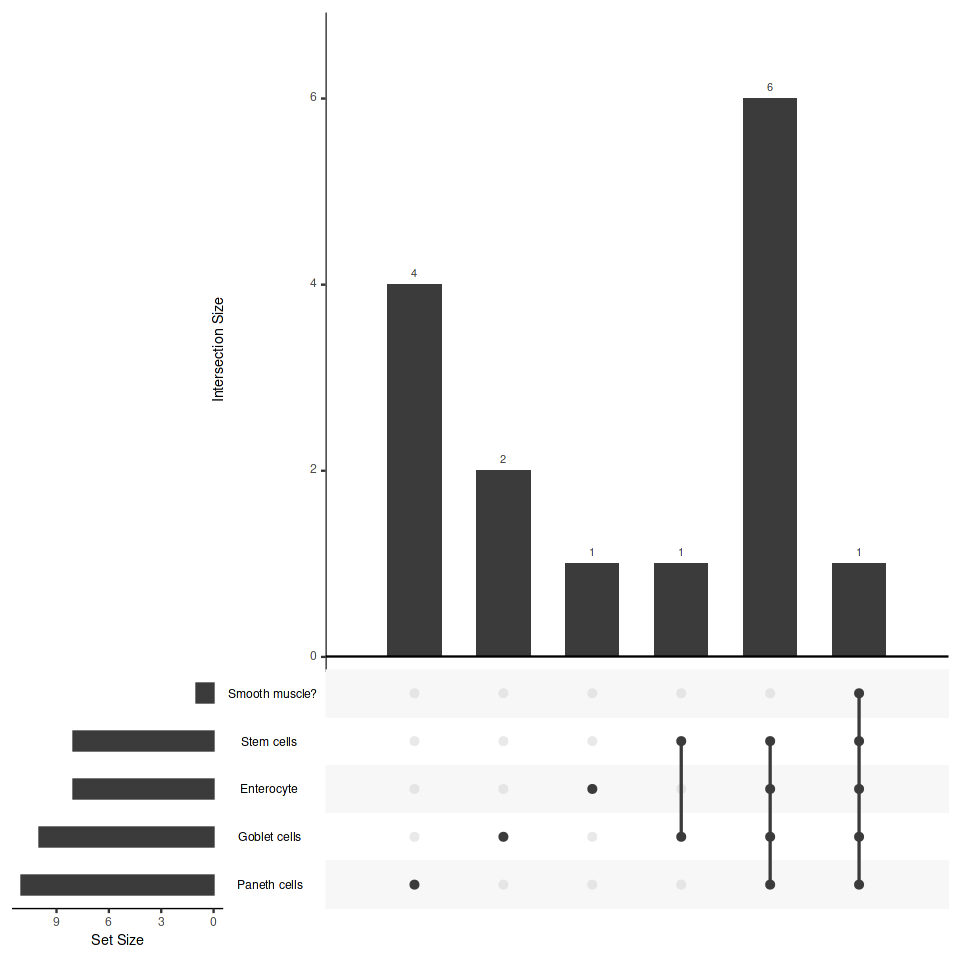

In [537]:
# Included are DS findings (FDR < 0.05, |logFC| > 1) across all clusters;
de_gs_by_k <- map(tbl_fil, "gene")
upset(fromList(de_gs_by_k)) 

### Cell-level viz.: Violin plots
- For changes of high interest, we can view the cell-level expression profiles of a specific gene across samples or groups using plotExpression (scater package).
- Here, we generate violin plots for the DS genes (lowest adj. p-value) of each cluster
- Note that, as DS testing is done at the cluster-level, we need to subset the cells that have been assigned to the corresponding cluster for plotting.
- (e.g. caption) Shown are the top 6 hits (lowest adj. p-value) for the B cells cluster. Each violin is a sample; points are colored by group ID.

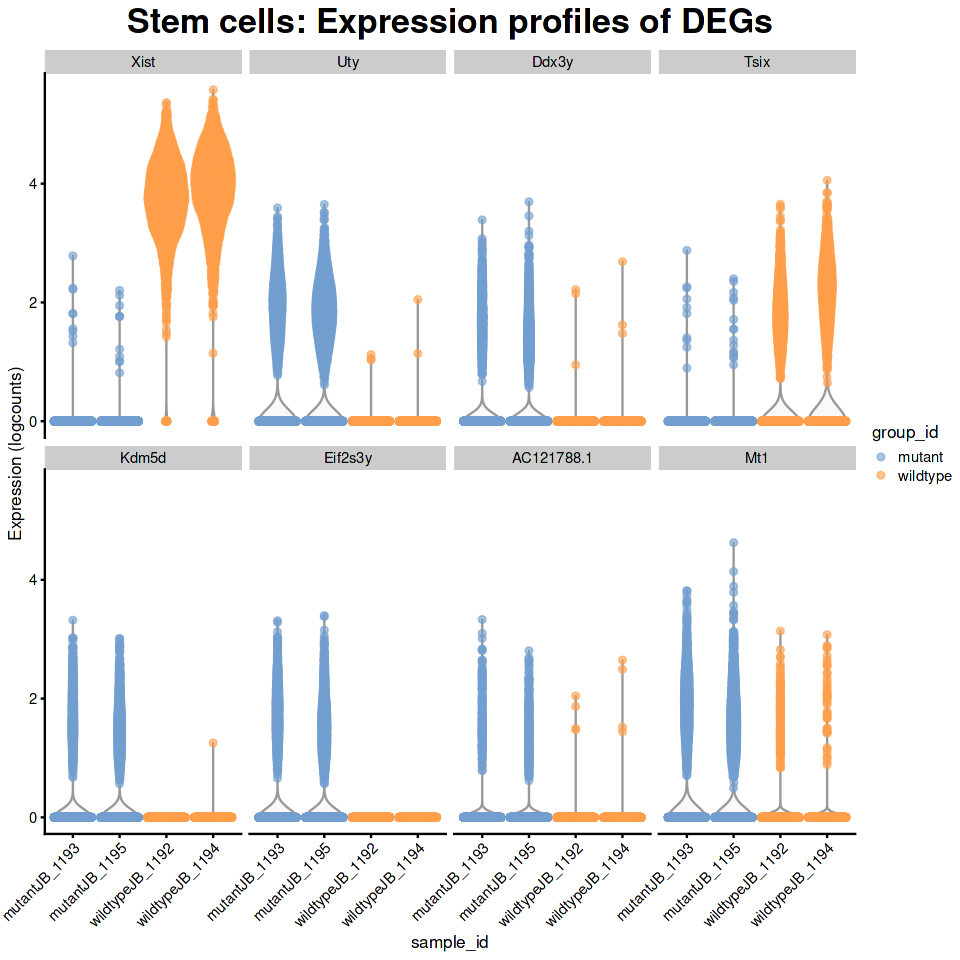

In [530]:
# Stem cells
plotExpression(sce[, sce$cluster_id == "Stem cells"], 
               features = tbl_fil$`Stem cells`$gene[seq_len(8)],
               x = "sample_id", 
               colour_by = "group_id", 
               ncol = 4) +
    guides(fill = guide_legend(override.aes = list(size = 5, alpha = 1))) +
    theme(   axis.text.x = element_text(angle = 45, hjust = 1),
             plot.title = element_text(size = 20, hjust = 0.5) ) + 
    ggtitle("Stem cells: Expression profiles of DEGs")

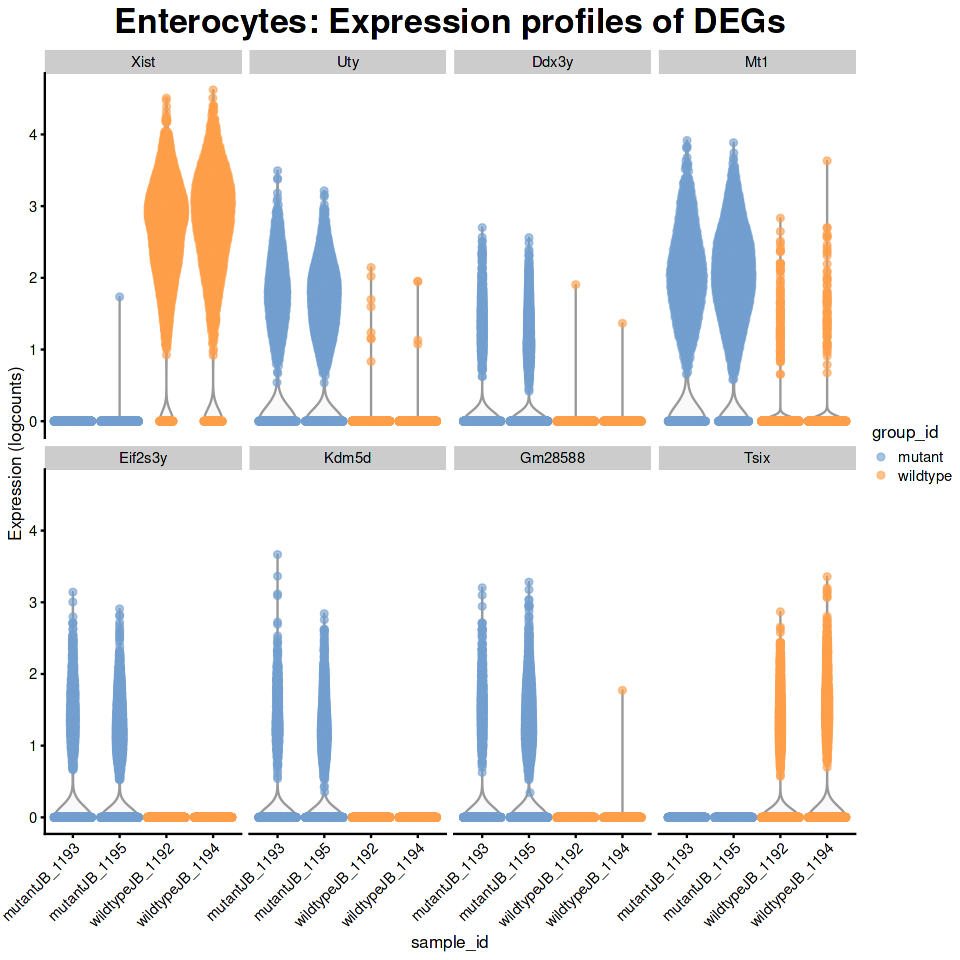

In [531]:
# Enterocytes
plotExpression(sce[, sce$cluster_id == "Enterocyte"], 
               features = tbl_fil$`Enterocyte`$gene[seq_len(8)],
               x = "sample_id", 
               colour_by = "group_id", 
               ncol = 4) +
    guides(fill = guide_legend(override.aes = list(size = 5, alpha = 1))) +
    theme(   axis.text.x = element_text(angle = 45, hjust = 1),
             plot.title = element_text(size = 20, hjust = 0.5) ) + 
    ggtitle("Enterocytes: Expression profiles of DEGs")

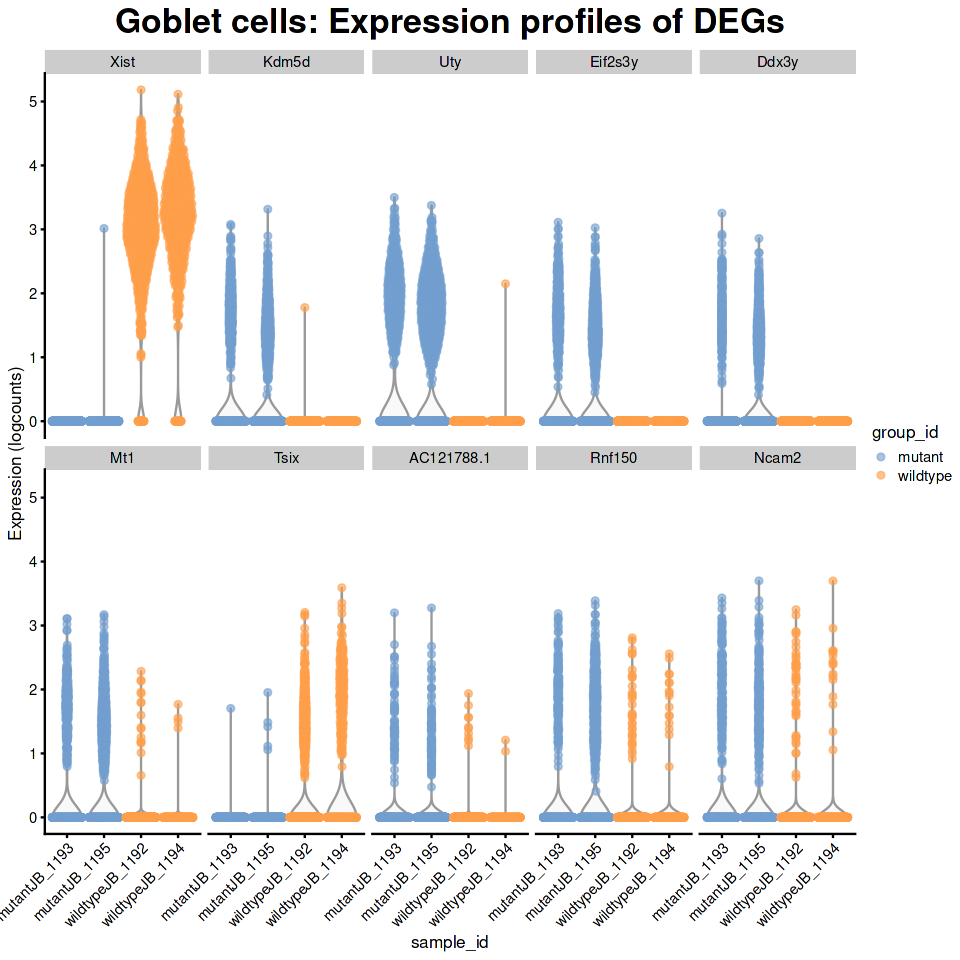

In [532]:
# Goblet cells
plotExpression(sce[, sce$cluster_id == "Goblet cells"], 
               features = tbl_fil$`Goblet cells`$gene[seq_len(10)],
               x = "sample_id", 
               colour_by = "group_id", 
               ncol = 5) +
    guides(fill = guide_legend(override.aes = list(size = 5, alpha = 1))) +
    theme(   axis.text.x = element_text(angle = 45, hjust = 1),
             plot.title = element_text(size = 20, hjust = 0.5) ) + 
    ggtitle("Goblet cells: Expression profiles of DEGs")

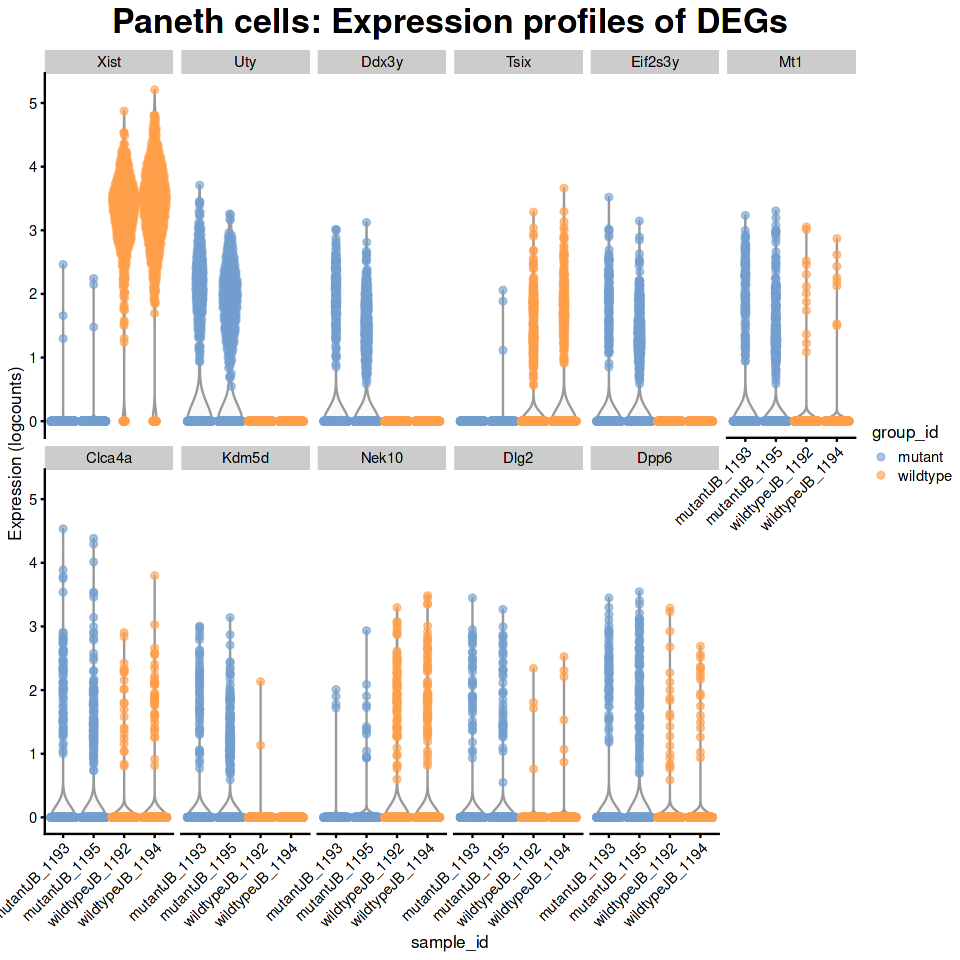

In [533]:
# Paneth cells
plotExpression(sce[, sce$cluster_id == "Paneth cells"], 
               features = tbl_fil$`Paneth cells`$gene[seq_len(11)],
               x = "sample_id", 
               colour_by = "group_id", 
               ncol = 6) +
    guides(fill = guide_legend(override.aes = list(size = 5, alpha = 1))) +
    theme(   axis.text.x = element_text(angle = 45, hjust = 1),
             plot.title = element_text(size = 20, hjust = 0.5) ) + 
    ggtitle("Paneth cells: Expression profiles of DEGs")

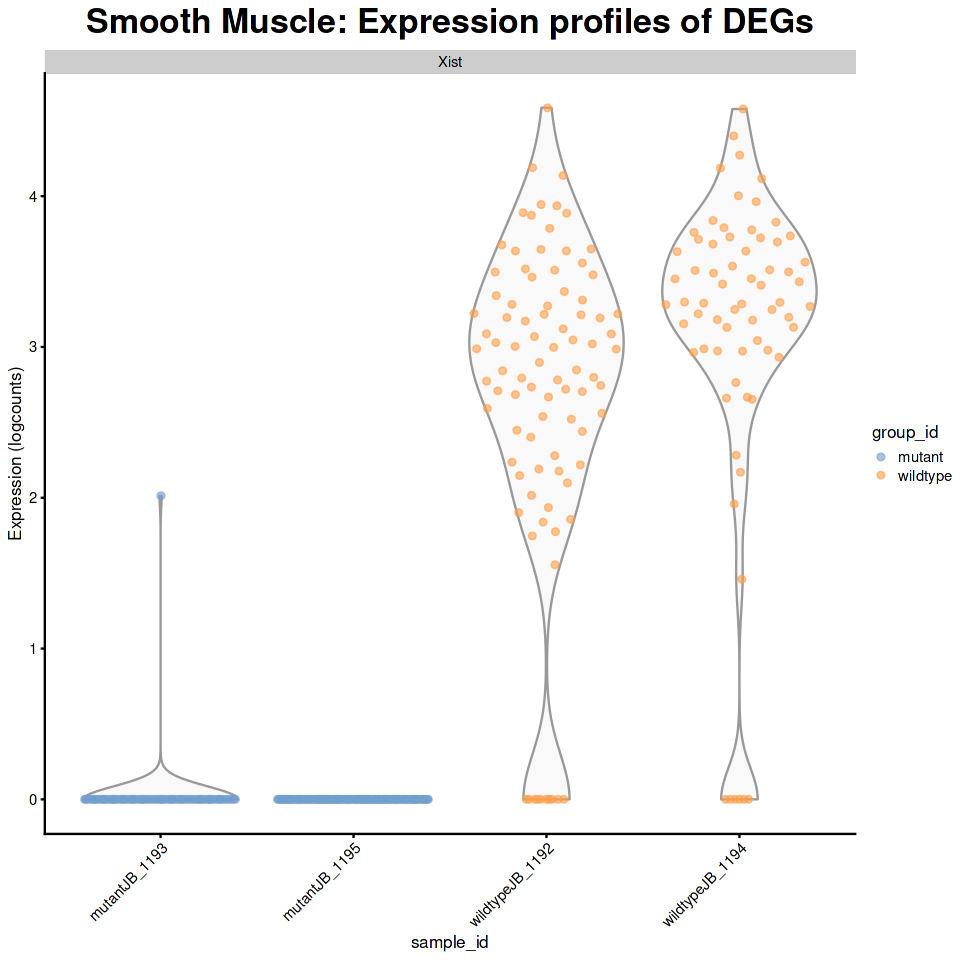

In [534]:
# Smooth muscle?
plotExpression(sce[, sce$cluster_id == "Smooth muscle?"], 
               features = tbl_fil$`Smooth muscle?`$gene[seq_len(1)],
               x = "sample_id", 
               colour_by = "group_id", 
               ncol = 1) +
    guides(fill = guide_legend(override.aes = list(size = 5, alpha = 1))) +
    theme(   axis.text.x = element_text(angle = 45, hjust = 1),
             plot.title = element_text(size = 20, hjust = 0.5) ) + 
    ggtitle("Smooth Muscle: Expression profiles of DEGs")

### Sample-level viz.: Pseudobulk heatmaps
- Especially when wanting to gain an overview of numerous DE testing results for many clusters, both dimension reduction and cell-level visualisations require a lot of space can become cumbersome to interpret.
- In this setting, it is thus recommended to visualise aggregated measures, e.g., mean expressions by cluster sample.

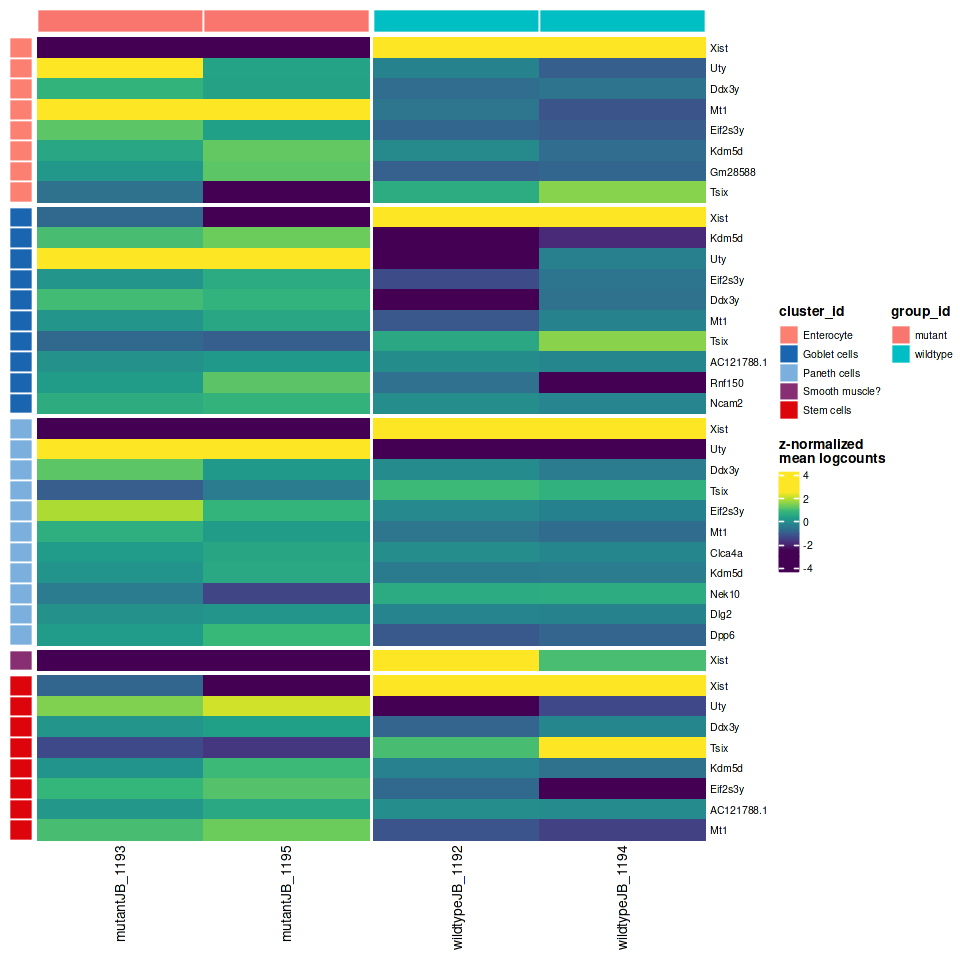

In [538]:
# top-5 DS genes per cluster
pbHeatmap(sce, res, top_n = 11)